
<br>
<font>
<div dir=ltr align=center>
<font color=0F5298 size=7>
    Machine Learning <br> <br>
<font color=2565AE size=5>
    CE Department <br>
    Fall 2024 - Prof. Sharifi Zarchi<br>
<font color=3C99D size=5>
    HW4 Practical <br>
    Image Colorization<br>
    Image Segmentation<br>
<font color=696880 size=4>
    Shayan Shabani


In [ ]:
from google.colab import drive
drive.mount('/content/drive/')

Mounted at /content/drive/


This assignment is structured to introduce students to practical applications of generative models in computer vision.
It targets two challenging areas: colorization and segmentation, using architectures that are complex but very applicable in industry settings.
## Machine Learning Assignment #4: Practical Applications in Image Processing

## Learning Objectives:
By the end of this assignment, students will be able to:
1. Understand and implement Variational Autoencoders for image colorization.
2. Apply the U-Net architecture for image segmentation.
3. Preprocess image datasets, including augmentation techniques.
4. Analyze the performance of machine learning models using relevant metrics.
5. Explore the relationship between latent space and output quality in generative models.


# Image Colorization using VAE
In this section of the assignment, students will explore the fascinating field of image colorization using Variational Autoencoders (VAEs), a type of generative model in deep learning. The task involves transforming grayscale images into colored ones, leveraging the encoder-decoder architecture of VAEs, which are adept at learning complex data distributions. Students will implement and fine-tune an autoencoder network, utilizing components like perceptual loss and feature extraction from pre-trained models, to improve colorization output. By doing so, they will gain a deeper understanding of generative models and their practical applications in computer vision tasks. This exercise offers a hands-on opportunity to blend theoretical knowledge with practical coding skills, characterizing the creative potential of AI in image processing.

Dataset: https://drive.google.com/drive/folders/1KeJbfUykGnPlz0q08_b1IjtW8OxkPdQ9?usp=sharing

## Importing Libraries

In [ ]:
!pip install pytorch_lightning
!pip install seaborn

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 815.2/815.2 kB 40.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 926.4/926.4 kB 53.4 MB/s eta 0:00:00


In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sea
from tqdm.notebook import tqdm
import os
import torch
import torch.nn as nn
import pytorch_lightning as pl
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
import torch.nn.functional as F
import torchmetrics
from torchmetrics import Metric
import torchvision
import math
print(plt.style.available)
plt.style.use('seaborn-v0_8')
device = 'cuda' if torch.cuda.is_available() else 'cpu'

np.__version__, device

from PIL import Image
from sklearn.manifold import TSNE


['Solarize_Light2', '_classic_test_patch', '_mpl-gallery', '_mpl-gallery-nogrid', 'bmh', 'classic', 'dark_background', 'fast', 'fivethirtyeight', 'ggplot', 'grayscale', 'seaborn-v0_8', 'seaborn-v0_8-bright', 'seaborn-v0_8-colorblind', 'seaborn-v0_8-dark', 'seaborn-v0_8-dark-palette', 'seaborn-v0_8-darkgrid', 'seaborn-v0_8-deep', 'seaborn-v0_8-muted', 'seaborn-v0_8-notebook', 'seaborn-v0_8-paper', 'seaborn-v0_8-pastel', 'seaborn-v0_8-poster', 'seaborn-v0_8-talk', 'seaborn-v0_8-ticks', 'seaborn-v0_8-white', 'seaborn-v0_8-whitegrid', 'tableau-colorblind10']


## Loading the Data

In [ ]:
import os
import pandas as pd
from tqdm import tqdm

def load_data(PATH):
    # TODO: Initialize lists to store filenames and their corresponding outcomes
    filenames = []
    outcomes = []

    # TODO: Create a DataFrame from the filenames and outcomes
    for root, _, files in os.walk(PATH):
        for file in files:
            if file.endswith('.jpg') or file.endswith('.png'):
                filenames.append(os.path.join(root, file))
                # outcomes.append(os.path.basename(root))
                outcomes.append(root.split('/')[-1])

    df = pd.DataFrame({'filename': filenames, 'outcome': outcomes})

    # TODO: Return the shuffled DataFrame
    df = df.sample(frac=1).reset_index(drop=True)
    return df


# TODO: Load the training, validation, and test data using the load_data function
train_df = load_data('/content/drive/MyDrive/col_archive/train')
val_df = load_data('/content/drive/MyDrive/col_archive/valid')
test_df = load_data('/content/drive/MyDrive/col_archive/test')

# TODO: Check the shape of the loaded DataFrames to verify correct data loading
print(train_df.shape, val_df.shape, test_df.shape)

(3208, 2) (100, 2) (100, 2)


In [ ]:
# TODO: Combine the training and test data into a single DataFrame along the vertical axis
combined_df = pd.concat([train_df, test_df], axis=0)
print(combined_df.shape)

(3308, 2)


In [ ]:
# TODO: Explore the new DataFrame
combined_df.head() # we used alphabetic outcome instead of numbers

,filename,outcome
0,/content/drive/MyDrive/col_archive/train/AFRIC...,AFRICAN FIREFINCH
1,/content/drive/MyDrive/col_archive/train/AMERI...,AMERICAN AVOCET
2,/content/drive/MyDrive/col_archive/train/AMERI...,AMERICAN AVOCET
3,/content/drive/MyDrive/col_archive/train/ALBER...,ALBERTS TOWHEE
4,/content/drive/MyDrive/col_archive/train/ALBAT...,ALBATROSS


## Plot some of the images

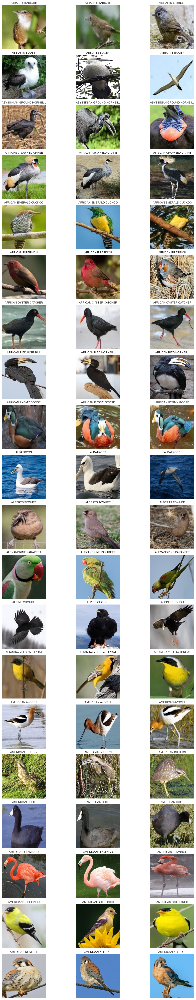

In [ ]:
# def plot_images(df, num_images=60):
#     fig, axes = plt.subplots(20, 3, figsize=(15, 50))
#     axes = axes.flatten()

#     for i, (idx, row) in enumerate(df.iterrows()):
#         if i >= num_images:
#             break
#         img = Image.open(row['filename'])
#         axes[i].imshow(img)
#         axes[i].set_title(row['outcome'])
#         axes[i].axis('off')

#     plt.tight_layout()
#     plt.show()

def plot_images(df, num_images=60):
    grouped = df.groupby('outcome') # Group by the 'outcome' column
    samples_per_class = 3
    classes = grouped.size().index.tolist()  # Get unique classes
    rows = len(classes)

    fig, axes = plt.subplots(rows, samples_per_class, figsize=(15, rows * 3))
    axes = axes.reshape(rows, samples_per_class)

    for row, (class_name, group) in enumerate(grouped):
        # Select up to `samples_per_class` images from this group
        samples = group.sample(n=samples_per_class, replace=False)  # Ensure randomness within class

        for col, (_, img_row) in enumerate(samples.iterrows()):
            img = Image.open(img_row['filename'])
            axes[row][col].imshow(img)
            axes[row][col].set_title(class_name)
            axes[row][col].axis('off')

    plt.tight_layout()
    plt.show()

plot_images(train_df)


## Dataset Distribution
plot the distribution of the dataset, both training and validation set

In [ ]:
# Define a mapping from class names to numerical values
class_to_number = {class_name: idx for idx, class_name in enumerate(combined_df['outcome'].unique())}

# Update the outcome column in train_df and val_df
combined_df['outcome'] = combined_df['outcome'].map(class_to_number)
val_df['outcome'] = val_df['outcome'].map(class_to_number)

# Verify the update
print(combined_df['outcome'].unique())
print(val_df['outcome'].unique())

[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19]
[ 4  2  0 12 16 17 14  9 15 13  7 11 18  3  8  1  5 19  6 10]


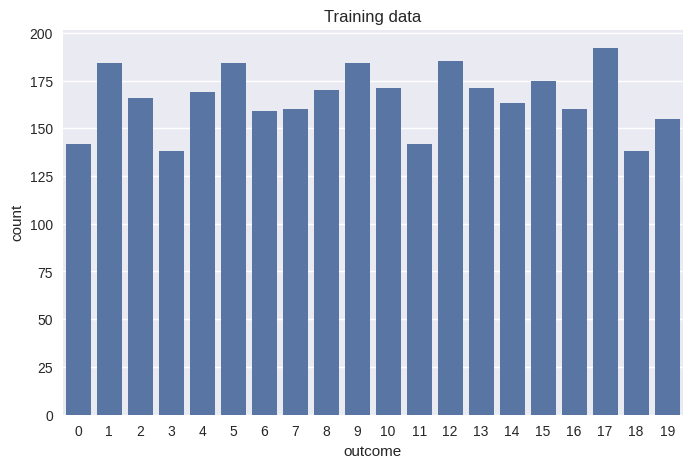

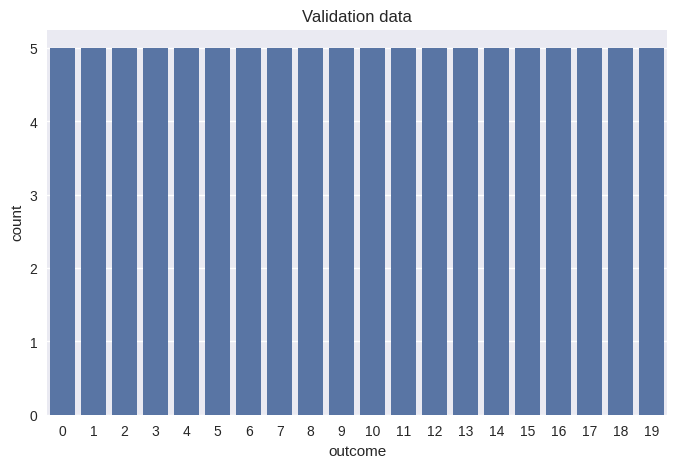

In [ ]:
# TODO: Plot the distribution of classes
import seaborn as sns

def plot_distribution(df, title):
    plt.figure(figsize=(8, 5))
    sns.countplot(x='outcome', data=df)
    plt.title(title)
    plt.xlabel('outcome')
    plt.ylabel('count')
    plt.show()

# Plot the distribution of classes
plot_distribution(combined_df, 'Training data')
plot_distribution(val_df, 'Validation data')

## Dataset Preparation
Now we are going to build the dataset by using `Dataset` and `DataLoader` classes within PyTorch. I recommend you to randomly crop the images to (160, 160) and then normalize them.

In [ ]:
class BirdDataset:
    def __init__(self, df, transform = None):
        # TODO: Initialize the needed data
        self.df = df
        self.transform = transform

    def __len__(self):
        # pass
        return len(self.df)

    def __getitem__(self, idx):
        # TODO: Load and transform an image
        # - Image should be converted to grayscale and then transformed
        # pass
        img_path = self.df.iloc[idx]['filename']
        label = self.df.iloc[idx]['outcome']
        color = Image.open(img_path).convert("RGB")
        grayscale = color.convert("L")

        if self.transform:
            grayscale = self.transform(grayscale)
            color = self.transform(color)

        return grayscale, color

# TODO: Apply preprocessings on the image dataset (increasing saturation, ...) by using transforms.ColorJitter for example.
# Data Augmentation
train_transform = transforms.Compose([
    transforms.RandomResizedCrop((160, 160)),
    transforms.ColorJitter(brightness=0.2, contrast=0.2, saturation=0.3, hue=0.1),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.5], std=[0.5])
])

val_transform = transforms.Compose([
    transforms.Resize((160, 160)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.5], std=[0.5])
])

# TODO: Define transforms and datasets and data loaders
train_dataset = BirdDataset(combined_df, transform=train_transform)
val_dataset = BirdDataset(val_df, transform=val_transform)

train_loader = DataLoader(train_dataset, batch_size=128, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=128, shuffle=False)

# class BirdDataset(Dataset):
#     def __init__(self, df, transform=None):
#         self.df = df
#         self.transform = transform

#     def __len__(self):
#         return len(self.df)

#     def __getitem__(self, idx):
#         img_path = self.df.iloc[idx]['filename']
#         image = Image.open(img_path).convert('RGB')

#         if self.transform:
#             image = self.transform(image)

#         # grayscale_image = transforms.functional.to_grayscale(image, num_output_channels=1)
#         grayscale_image = transforms.functional.rgb_to_grayscale(image, num_output_channels=1)

#         return grayscale_image, image

# # Define transformations
# # transform = transforms.Compose([
# #     transforms.Resize((160, 160)),
# #     transforms.ColorJitter(brightness=0.2, contrast=0.2, saturation=0.3, hue=0.2),
# #     transforms.ToTensor(),
# #     transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
# # ])

# train_transform = transforms.Compose([
#     transforms.RandomResizedCrop((160, 160)),
#     transforms.RandomHorizontalFlip(p=0.5),
#     # transforms.ColorJitter(brightness=0.2, contrast=0.2, saturation=0.3, hue=0.1),
#     transforms.ToTensor(),
#     # transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
#     transforms.Normalize(mean=[0.5], std=[0.5])

# ])

# val_transform = transforms.Compose([
#     transforms.Resize((160, 160)),
#     transforms.ToTensor(),
#     # transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
#     transforms.Normalize(mean=[0.5], std=[0.5])
# ])

# # Create datasets and data loaders
# train_dataset = BirdDataset(train_df, transform=train_transform)
# val_dataset = BirdDataset(val_df, transform=val_transform)

# train_loader = DataLoader(train_dataset, batch_size=32, shuffle=True)
# val_loader = DataLoader(val_dataset, batch_size=32, shuffle=False)

In [ ]:
for grayscale, color in train_loader:
    print(f"grayscale.shape: {grayscale.shape}")
    print(f"max.grayscale.shape: {max(grayscale.reshape(-1))}")
    print(f"min.grayscale.shape: {min(grayscale.reshape(-1))}")
    print("----------------------")
    print(f"color.shape: {color.shape}")
    print(f"max.color.shape: {max(color.reshape(-1))}")
    print(f"min.color.shape: {min(color.reshape(-1))}")
    break

grayscale.shape: torch.Size([32, 1, 160, 160])
max.grayscale.shape: 1.0
min.grayscale.shape: -1.0
----------------------
color.shape: torch.Size([32, 3, 160, 160])
max.color.shape: 1.0
min.color.shape: -1.0


**Why is data augmentation pivotal in training models for image tasks, and what techniques are beneficial for this particular assignment?**

*Data augmentation is pivotal in training models for image tasks because it helps to increase the diversity of the training data, which can improve the model's generalization ability. Data augmentation increases the diversity of the training dataset without collecting new data. This helps the model generalize better and reduces overfitting.
For this assignment, techniques like Color Jittering (adjusting brightness, contrast, saturation, and hue), and Random Cropping are beneficial as they simulate real-world variations in lighting, shading, and image quality. We could also use flipping and other methods but for the sake of simplicity we did not do it.*

- Color Jittering: Randomly changing the brightness, contrast, saturation, and hue of the images.
- Random Cropping: Cropping the images to a fixed size randomly.
- Normalization: Normalizing the pixel values to have a mean of 0.5 and a standard deviation of 0.5.

## Model Architecture
The model has an encoder block for encoding the grayscale image into a lower representation followed by a decoder block to generate the colorized image.

In [ ]:
# import torchvision.models as models
# import torch.nn as nn
# import torch
# import torch.optim as optim
# from tqdm import tqdm
# import math
# from torchvision import transforms

# # # The following classes define the various components of our VAE model.
# # # Each class includes a simple explanation of its role in the overall architecture.

# # # The VAE consists of an encoder to compress the input into a smaller latent representation,
# # # and a decoder to reconstruct the colorized output from the latent space.


# # # Hint for students: Initialize the perceptual loss with different feature layers based on the network architecture.
# # # - You have to use VGG pretrained model for this part
# class PerceptualLoss(nn.Module):
#     def __init__(self, feature_layers=None, use_half=False):
#         super(PerceptualLoss, self).__init__()
#         self.vgg = models.vgg16(pretrained=True).features.to(device).eval()
#         self.feature_layers = feature_layers
#         self.use_half = use_half
#         if self.use_half:
#             self.vgg.half()

#     def forward(self, x, y):
#         if self.feature_layers is None:
#             self.feature_layers = [0, 5, 10, 17, 24, 31]

#         x_features = self.extract_features(x, self.feature_layers)
#         y_features = self.extract_features(y, self.feature_layers)

#         loss = 0
#         for x_feat, y_feat in zip(x_features, y_features):
#             loss += F.mse_loss(x_feat, y_feat)

#         return loss

#     def extract_features(self, x, feature_layers):
#         features = []
#         for i, layer in enumerate(self.vgg):
#             x = layer(x)
#             if i in feature_layers:
#                 features.append(x)
#             if i == feature_layers[-1]:
#                 break
#         return features

# # Hint: Define the structure of the encoder by using convolutional layers with optional batch normalization.
# class Encoder(nn.Module):
#     def __init__(self, do_bn=False):
#         super(Encoder, self).__init__()
#         self.do_bn = do_bn
#         self.conv1 = self.inner_block(1, 64, maxpool=2)
#         self.conv2 = self.inner_block(64, 128, maxpool=2)
#         self.conv3 = self.inner_block(128, 256, maxpool=2)
#         self.conv4 = self.inner_block(256, 512, maxpool=2)
#         self.conv5 = self.inner_block(512, 512, maxpool=2)
#         self.fc_mu = nn.Linear(512 * 10 * 10, 256)
#         self.fc_logvar = nn.Linear(512 * 10 * 10, 256)

#     def inner_block(self, in_c, out_c, maxpool=2):
#         layers = [
#             nn.Conv2d(in_c, out_c, kernel_size=3, padding=1),
#             nn.BatchNorm2d(out_c) if self.do_bn else nn.Identity(),
#             nn.ReLU(inplace=True),
#             nn.MaxPool2d(maxpool)
#         ]
#         return nn.Sequential(*layers)

#     def forward(self, x):
#         x = self.conv1(x)
#         x = self.conv2(x)
#         x = self.conv3(x)
#         x = self.conv4(x)
#         x = self.conv5(x)
#         x = x.view(x.size(0), -1)
#         mu = self.fc_mu(x)
#         logvar = self.fc_logvar(x)
#         return mu, logvar

# # Hint: Define the decoder's symmetric structure to the encoder for upsampling and reconstructing the input.
# class Decoder(nn.Module):
#     def __init__(self, do_bn):
#         super(Decoder, self).__init__()
#         self.do_bn = do_bn
#         self.fc = nn.Linear(256, 512 * 10 * 10)
#         self.deconv1 = self.inner_block(512, 512)
#         self.deconv2 = self.inner_block(512, 256)
#         self.deconv3 = self.inner_block(256, 128)
#         self.deconv4 = self.inner_block(128, 64)
#         self.deconv5 = self.conv_block(64, 3)

#     def inner_block(self, in_c, out_c, out=False):
#         layers = [
#             nn.ConvTranspose2d(in_c, out_c, kernel_size=3, stride=2, padding=1, output_padding=1),
#             nn.BatchNorm2d(out_c) if self.do_bn else nn.Identity(),
#             nn.ReLU(inplace=True)
#         ]
#         return nn.Sequential(*layers)

#     def conv_block(self, in_c, out_c):
#         layers = [
#             nn.ConvTranspose2d(in_c, out_c, kernel_size=3, stride=1, padding=1),
#             nn.Tanh()
#         ]
#         return nn.Sequential(*layers)

#     def forward(self, h):
#         h = self.fc(h).view(h.size(0), 512, 10, 10)
#         h = self.deconv1(h)
#         h = self.deconv2(h)
#         h = self.deconv3(h)
#         h = self.deconv4(h)
#         h = self.deconv5(h)
#         return h

# # Hint: Integrate the encoder, decoder, and loss components into the overall network class.
# class Net(nn.Module):
#     def __init__(self):
#         super(Net, self).__init__()
#         self.encoder = Encoder(do_bn=True)
#         self.decoder = Decoder(do_bn=True)
#         self.perceptual_loss = PerceptualLoss()
#         self.reconstruction_loss = nn.MSELoss()

#     def forward(self, x):
#         mu, logvar = self.encoder(x)
#         z = self.reparameterize(mu, logvar)
#         return self.decoder(z), mu, logvar

#     def reparameterize(self, mu, logvar):
#         std = torch.exp(0.5 * logvar)
#         eps = torch.randn_like(std)
#         return mu + eps * std

#     def compute_loss(self, pred, target, mu, logvar):
#         recon_loss = self.reconstruction_loss(pred, target)
#         perceptual_loss = self.perceptual_loss(pred, target)
#         kld_loss = -0.5 * torch.sum(1 + logvar - mu.pow(2) - logvar.exp())
#         return recon_loss + perceptual_loss + kld_loss

#     def training_step(self, X):
#         grayscale, color = X
#         grayscale, color = grayscale.to(device), color.to(device)
#         pred, mu, logvar = self(grayscale)
#         loss = self.compute_loss(pred, color, mu, logvar)
#         return loss

#     def validation_step(self, X):
#         grayscale, color = X
#         grayscale, color = grayscale.to(device), color.to(device)
#         pred, mu, logvar = self(grayscale)
#         loss = self.compute_loss(pred, color, mu, logvar)
#         return loss

#     def train_model(self, epochs=10):
#         optimizer = optim.Adam(self.parameters(), lr=1e-3)
#         train_losses = []
#         val_losses = []

#         for epoch in range(epochs):
#             self.train()
#             train_loss = 0
#             for batch in tqdm(train_loader):
#                 optimizer.zero_grad()
#                 loss = self.training_step(batch)
#                 loss.backward()
#                 optimizer.step()
#                 train_loss += loss.item()

#             train_loss /= len(train_loader)
#             train_losses.append(train_loss)

#             self.eval()
#             val_loss = 0
#             with torch.no_grad():
#                 for batch in val_loader:
#                     loss = self.validation_step(batch)
#                     val_loss += loss.item()

#             val_loss /= len(val_loader)
#             val_losses.append(val_loss)

#             print(f'Epoch {epoch+1}/{epochs}, Train Loss: {train_loss:.4f}, Val Loss: {val_loss:.4f}')

#         return train_losses, val_losses


In [ ]:
# # Define Perceptual Loss class
# class PerceptualLoss(nn.Module):
#     def __init__(self, feature_layers=None):
#         super(PerceptualLoss, self).__init__()
#         vgg = models.vgg19(pretrained=True).features
#         self.feature_extractor = nn.Sequential(*list(vgg[:feature_layers]).eval())
#         for param in self.feature_extractor.parameters():
#             param.requires_grad = False

#     def forward(self, x, y):
#         x_features = self.feature_extractor(x)
#         y_features = self.feature_extractor(y)
#         return nn.functional.mse_loss(x_features, y_features)

# # Define Encoder class
# class Encoder(nn.Module):
#     def __init__(self, latent_dim):
#         super(Encoder, self).__init__()
#         self.conv = nn.Sequential(
#             nn.Conv2d(1, 32, 4, 2, 1),
#             nn.ReLU(),
#             nn.Conv2d(32, 64, 4, 2, 1),
#             nn.ReLU()
#         )
#         self.fc_mu = nn.Linear(64 * 20 * 20, latent_dim)
#         self.fc_logvar = nn.Linear(64 * 20 * 20, latent_dim)

#     def forward(self, x):
#         x = self.conv(x).view(x.size(0), -1)
#         mu = self.fc_mu(x)
#         logvar = self.fc_logvar(x)
#         return mu, logvar

# # Define Decoder class
# class Decoder(nn.Module):
#     def __init__(self, latent_dim):
#         super(Decoder, self).__init__()
#         self.fc = nn.Linear(latent_dim, 64 * 20 * 20)
#         self.deconv = nn.Sequential(
#             nn.ConvTranspose2d(64, 32, 4, 2, 1),
#             nn.ReLU(),
#             nn.ConvTranspose2d(32, 3, 4, 2, 1),
#             nn.Sigmoid()
#         )

#     def forward(self, z):
#         z = self.fc(z).view(z.size(0), 64, 20, 20)
#         return self.deconv(z)

# # Define the full VAE model
# class VAE(nn.Module):
#     def __init__(self, latent_dim):
#         super(VAE, self).__init__()
#         self.encoder = Encoder(latent_dim)
#         self.decoder = Decoder(latent_dim)

#     def reparameterize(self, mu, logvar):
#         std = torch.exp(0.5 * logvar)
#         eps = torch.randn_like(std)
#         return mu + eps * std

#     def forward(self, x):
#         mu, logvar = self.encoder(x)
#         z = self.reparameterize(mu, logvar)
#         return self.decoder(z), mu, logvar

#     def loss_function(self, recon_x, x, mu, logvar):
#         recon_loss = nn.functional.mse_loss(recon_x, x, reduction='sum')
#         kld = -0.5 * torch.sum(1 + logvar - mu.pow(2) - logvar.exp())
#         return recon_loss + kld

# # Training loop
# def train_vae(model, train_loader, val_loader, epochs=10, lr=1e-3):
#     optimizer = optim.Adam(model.parameters(), lr=lr)
#     model.train()
#     train_losses, val_losses = [], []

#     for epoch in range(epochs):
#         train_loss = 0
#         for x_gray, x_color in tqdm(train_loader, desc=f"Training Epoch {epoch+1}/{epochs}"):
#             x_gray, x_color = x_gray.to(device), x_color.to(device)
#             optimizer.zero_grad()
#             recon_x, mu, logvar = model(x_gray)
#             loss = model.loss_function(recon_x, x_color, mu, logvar)
#             loss.backward()
#             optimizer.step()
#             train_loss += loss.item()

#         val_loss = 0
#         model.eval()
#         with torch.no_grad():
#             for x_gray, x_color in tqdm(val_loader, desc=f"Validation Epoch {epoch+1}/{epochs}"):
#                 x_gray, x_color = x_gray.to(device), x_color.to(device)
#                 recon_x, mu, logvar = model(x_gray)
#                 val_loss += model.loss_function(recon_x, x_color, mu, logvar).item()

#         train_losses.append(train_loss / len(train_loader.dataset))
#         val_losses.append(val_loss / len(val_loader.dataset))
#         print(f"Epoch {epoch + 1}, Train Loss: {train_loss}, Val Loss: {val_loss}")

#     return train_losses, val_losses


# latent_dim = 32
# vae = VAE(latent_dim).to(device)
# train_losses, val_losses = train_vae(vae, train_loader, val_loader, epochs=50)

In [ ]:
# Model Components
# class PerceptualLoss(nn.Module):
#     def __init__(self):
#         super(PerceptualLoss, self).__init__()
#         vgg = torchvision.models.vgg16(pretrained=True).features
#         self.layers = nn.Sequential(*list(vgg.children())[:12])
#         for param in self.layers.parameters():
#             param.requires_grad = False

#     def forward(self, x, y):
#         # Resize x and y to match the expected input size of the VGG layers
#         x = F.interpolate(x, size=(160, 160), mode='bilinear', align_corners=False)
#         y = F.interpolate(y, size=(160, 160), mode='bilinear', align_corners=False)

#         x_features = self.layers(x)
#         y_features = self.layers(y)
#         return F.mse_loss(x_features, y_features)

class PerceptualLoss(nn.Module):
    def __init__(self, feature_layers=None, use_half=False):
        super(PerceptualLoss, self).__init__()
        vgg = torchvision.models.vgg16(pretrained=True).features
        self.feature_layers = feature_layers if feature_layers else list(range(12))
        self.layers = nn.Sequential(*[vgg[i] for i in self.feature_layers])
        for param in self.layers.parameters():
            param.requires_grad = False
        self.use_half = use_half

    def forward(self, x, y):
        x = F.interpolate(x, size=(224, 224), mode='bilinear', align_corners=False)
        y = F.interpolate(y, size=(224, 224), mode='bilinear', align_corners=False)
        if self.use_half:
            x, y = x.half(), y.half()
        x_features = self.layers(x)
        y_features = self.layers(y)
        return F.mse_loss(x_features, y_features)

class Encoder(nn.Module):
    def __init__(self, do_bn=True):
        super(Encoder, self).__init__()
        self.do_bn = do_bn

        # self.enc1 = self.inner_block(1, 32)
        # self.enc2 = self.inner_block(32, 64)
        # self.enc3 = self.inner_block(64, 128)

        # self.enc1 = self.inner_block(1, 16)
        # self.enc2 = self.inner_block(16, 32)
        # self.enc3 = self.inner_block(32, 64)

        self.enc1 = self.inner_block(1, 8)
        self.enc2 = self.inner_block(8, 16)

    def inner_block(self, in_c, out_c, maxpool=2):
        layers = [nn.Conv2d(in_c, out_c, kernel_size=3, stride=1, padding=1)]
        if self.do_bn:
            layers.append(nn.BatchNorm2d(out_c))
        layers.extend([
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=maxpool),
            nn.Dropout(0.01)
        ])
        return nn.Sequential(*layers)

    def forward(self, x):
        x = self.enc1(x)
        # After enc1 torch.Size([64, 32, 80, 80])

        x = self.enc2(x)
        # After enc2: torch.Size([64, 64, 40, 40])

        # x = self.enc3(x)
        # After enc3: torch.Size([64, 128, 20, 20])
        return x

class Decoder(nn.Module):
    def __init__(self, do_bn=True):
        super(Decoder, self).__init__()
        self.do_bn = do_bn

        # self.dec1 = self.inner_block(128, 64)
        # self.dec2 = self.inner_block(64, 32)
        # self.dec3 = self.conv_block(32, 3)

        # self.dec1 = self.inner_block(64, 32)
        # self.dec2 = self.inner_block(32, 16)
        # self.dec3 = self.inner_block(16, 3)
        # self.conv = self.conv_block(3, 3)

        self.dec1 = self.inner_block(16, 8)
        self.dec2 = self.inner_block(8, 3)
        self.conv = self.conv_block(3, 3)

    def inner_block(self, in_c, out_c, out=False):
        # layers = [
        #     nn.ConvTranspose2d(in_c, out_c, kernel_size=3, stride=2, padding=1, output_padding=1)
        # ]
        # if self.do_bn:
        #     layers.append(nn.BatchNorm2d(out_c))
        # layers.append(nn.ReLU() if not out else nn.Tanh())
        # return nn.Sequential(*layers)

        layers = [
            nn.ConvTranspose2d(in_c, out_c, kernel_size=4, stride=2, padding=1)
        ]
        if self.do_bn:
            layers.append(nn.BatchNorm2d(out_c))
        layers.append(nn.ReLU() if not out else nn.Tanh())
        return nn.Sequential(*layers)

    def conv_block(self, in_c, out_c):
        return nn.Sequential(
            nn.Conv2d(in_c, out_c, kernel_size=3, stride=1, padding=1),
            nn.Tanh()
        )

    def forward(self, h):
        h = self.dec1(h)
        h = self.dec2(h)
        # h = self.dec3(h)
        h = self.conv(h)
        return h

class Net(nn.Module):
    def __init__(self):
        super(Net, self).__init__()
        self.encoder = Encoder()
        self.decoder = Decoder()
        self.criterion = PerceptualLoss()

    def forward(self, x):
        latent = self.encoder(x)
        return self.decoder(latent)

    def compute_loss(self, pred, target):
        perceptual_loss = self.criterion(pred, target)
        pixel_loss = F.mse_loss(pred, target)
        return perceptual_loss + pixel_loss

    def training_step(self, grayscale, color, optimizer):
        grayscale, color = grayscale.to(device), color.to(device)
        optimizer.zero_grad()
        output = self.forward(grayscale)
        loss = self.compute_loss(output, color)
        loss.backward()
        optimizer.step()
        return loss.item()

    def validation_step(self, grayscale, color):
        grayscale, color = grayscale.to(device), color.to(device)
        output = self.forward(grayscale)
        loss = self.compute_loss(output, color)
        return loss.item()

    def train_model(self, train_loader, val_loader, epochs=10, lr=1e-4):
        optimizer = torch.optim.Adam(self.parameters(), lr=lr)
        train_losses, val_losses = [], []

        for epoch in range(epochs):
            self.train()
            train_loss = 0
            for grayscale, color in tqdm(train_loader, desc=f"Epoch {epoch+1} - Training"):
                train_loss += self.training_step(grayscale, color, optimizer)

            train_losses.append(train_loss / len(train_loader))
            print(f"Epoch {epoch+1}, Train Loss: {train_losses[-1]}")

            self.eval()
            val_loss = 0
            with torch.no_grad():
                for grayscale, color in tqdm(val_loader, desc=f"Epoch {epoch+1} - Validation"):
                    val_loss += self.validation_step(grayscale, color)

            val_losses.append(val_loss / len(val_loader))
            print(f"Epoch {epoch+1}, Val Loss: {val_losses[-1]}")

        return train_losses, val_losses

# model = Net().to(device)

In [ ]:
# TODO: print the model
model = Net().to(device)
print(model)

Net(
  (encoder): Encoder(
    (enc1): Sequential(
      (0): Conv2d(1, 8, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): BatchNorm2d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU()
      (3): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
      (4): Dropout(p=0.01, inplace=False)
    )
    (enc2): Sequential(
      (0): Conv2d(8, 16, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): BatchNorm2d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU()
      (3): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
      (4): Dropout(p=0.01, inplace=False)
    )
  )
  (decoder): Decoder(
    (dec1): Sequential(
      (0): ConvTranspose2d(16, 8, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
      (1): BatchNorm2d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU()
    )
    (dec2): Sequential(
      (0): ConvT

## Training Phase

In [ ]:
train_losses, val_losses = model.train_model(train_loader, val_loader, epochs=50)

Epoch 1 - Training: 100%|██████████| 26/26 [00:55<00:00,  2.12s/it]


Epoch 1, Train Loss: 6.896974031741802


Epoch 1 - Validation: 100%|██████████| 1/1 [00:01<00:00,  1.26s/it]


Epoch 1, Val Loss: 3.6603641510009766


Epoch 2 - Training: 100%|██████████| 26/26 [00:54<00:00,  2.09s/it]


Epoch 2, Train Loss: 5.677322185956514


Epoch 2 - Validation: 100%|██████████| 1/1 [00:01<00:00,  1.26s/it]


Epoch 2, Val Loss: 5.144166946411133


Epoch 3 - Training: 100%|██████████| 26/26 [00:54<00:00,  2.08s/it]


Epoch 3, Train Loss: 5.092609277138343


Epoch 3 - Validation: 100%|██████████| 1/1 [00:01<00:00,  1.26s/it]


Epoch 3, Val Loss: 5.193233966827393


Epoch 4 - Training: 100%|██████████| 26/26 [00:54<00:00,  2.09s/it]


Epoch 4, Train Loss: 4.725444115125216


Epoch 4 - Validation: 100%|██████████| 1/1 [00:01<00:00,  1.29s/it]


Epoch 4, Val Loss: 4.863564968109131


Epoch 5 - Training: 100%|██████████| 26/26 [00:54<00:00,  2.09s/it]


Epoch 5, Train Loss: 4.457296774937556


Epoch 5 - Validation: 100%|██████████| 1/1 [00:01<00:00,  1.29s/it]


Epoch 5, Val Loss: 4.605260372161865


Epoch 6 - Training: 100%|██████████| 26/26 [00:53<00:00,  2.08s/it]


Epoch 6, Train Loss: 4.248427372712356


Epoch 6 - Validation: 100%|██████████| 1/1 [00:01<00:00,  1.39s/it]


Epoch 6, Val Loss: 4.40777587890625


Epoch 7 - Training: 100%|██████████| 26/26 [00:54<00:00,  2.10s/it]


Epoch 7, Train Loss: 4.0755520692238445


Epoch 7 - Validation: 100%|██████████| 1/1 [00:01<00:00,  1.37s/it]


Epoch 7, Val Loss: 4.221741676330566


Epoch 8 - Training: 100%|██████████| 26/26 [00:54<00:00,  2.10s/it]


Epoch 8, Train Loss: 3.929574865561265


Epoch 8 - Validation: 100%|██████████| 1/1 [00:01<00:00,  1.39s/it]


Epoch 8, Val Loss: 4.067403316497803


Epoch 9 - Training: 100%|██████████| 26/26 [00:54<00:00,  2.10s/it]


Epoch 9, Train Loss: 3.8033688343488254


Epoch 9 - Validation: 100%|██████████| 1/1 [00:01<00:00,  1.38s/it]


Epoch 9, Val Loss: 3.9402530193328857


Epoch 10 - Training: 100%|██████████| 26/26 [00:54<00:00,  2.10s/it]


Epoch 10, Train Loss: 3.688523081632761


Epoch 10 - Validation: 100%|██████████| 1/1 [00:01<00:00,  1.36s/it]


Epoch 10, Val Loss: 3.8169808387756348


Epoch 11 - Training: 100%|██████████| 26/26 [00:54<00:00,  2.09s/it]


Epoch 11, Train Loss: 3.5780682472082286


Epoch 11 - Validation: 100%|██████████| 1/1 [00:01<00:00,  1.37s/it]


Epoch 11, Val Loss: 3.7056946754455566


Epoch 12 - Training: 100%|██████████| 26/26 [00:54<00:00,  2.09s/it]


Epoch 12, Train Loss: 3.4687666526207557


Epoch 12 - Validation: 100%|██████████| 1/1 [00:01<00:00,  1.36s/it]


Epoch 12, Val Loss: 3.5859527587890625


Epoch 13 - Training: 100%|██████████| 26/26 [00:54<00:00,  2.10s/it]


Epoch 13, Train Loss: 3.3650886737383328


Epoch 13 - Validation: 100%|██████████| 1/1 [00:01<00:00,  1.38s/it]


Epoch 13, Val Loss: 3.4852569103240967


Epoch 14 - Training: 100%|██████████| 26/26 [00:54<00:00,  2.09s/it]


Epoch 14, Train Loss: 3.2661751967210035


Epoch 14 - Validation: 100%|██████████| 1/1 [00:01<00:00,  1.38s/it]


Epoch 14, Val Loss: 3.3769495487213135


Epoch 15 - Training: 100%|██████████| 26/26 [00:54<00:00,  2.10s/it]


Epoch 15, Train Loss: 3.1693565478691688


Epoch 15 - Validation: 100%|██████████| 1/1 [00:01<00:00,  1.35s/it]


Epoch 15, Val Loss: 3.288691520690918


Epoch 16 - Training: 100%|██████████| 26/26 [00:54<00:00,  2.09s/it]


Epoch 16, Train Loss: 3.084484045322125


Epoch 16 - Validation: 100%|██████████| 1/1 [00:01<00:00,  1.37s/it]


Epoch 16, Val Loss: 3.2039899826049805


Epoch 17 - Training: 100%|██████████| 26/26 [00:54<00:00,  2.09s/it]


Epoch 17, Train Loss: 3.0097053050994873


Epoch 17 - Validation: 100%|██████████| 1/1 [00:01<00:00,  1.38s/it]


Epoch 17, Val Loss: 3.1351466178894043


Epoch 18 - Training: 100%|██████████| 26/26 [00:54<00:00,  2.10s/it]


Epoch 18, Train Loss: 2.9477489911592922


Epoch 18 - Validation: 100%|██████████| 1/1 [00:01<00:00,  1.39s/it]


Epoch 18, Val Loss: 3.076752185821533


Epoch 19 - Training: 100%|██████████| 26/26 [00:54<00:00,  2.09s/it]


Epoch 19, Train Loss: 2.891692097370441


Epoch 19 - Validation: 100%|██████████| 1/1 [00:01<00:00,  1.35s/it]


Epoch 19, Val Loss: 3.0231404304504395


Epoch 20 - Training: 100%|██████████| 26/26 [00:54<00:00,  2.08s/it]


Epoch 20, Train Loss: 2.8399234918447642


Epoch 20 - Validation: 100%|██████████| 1/1 [00:01<00:00,  1.36s/it]


Epoch 20, Val Loss: 2.9748282432556152


Epoch 21 - Training: 100%|██████████| 26/26 [00:54<00:00,  2.09s/it]


Epoch 21, Train Loss: 2.793447522016672


Epoch 21 - Validation: 100%|██████████| 1/1 [00:01<00:00,  1.34s/it]


Epoch 21, Val Loss: 2.929971694946289


Epoch 22 - Training: 100%|██████████| 26/26 [00:54<00:00,  2.10s/it]


Epoch 22, Train Loss: 2.749263048171997


Epoch 22 - Validation: 100%|██████████| 1/1 [00:01<00:00,  1.35s/it]


Epoch 22, Val Loss: 2.8880577087402344


Epoch 23 - Training: 100%|██████████| 26/26 [00:54<00:00,  2.10s/it]


Epoch 23, Train Loss: 2.706650192920978


Epoch 23 - Validation: 100%|██████████| 1/1 [00:01<00:00,  1.40s/it]


Epoch 23, Val Loss: 2.847078561782837


Epoch 24 - Training: 100%|██████████| 26/26 [00:54<00:00,  2.10s/it]


Epoch 24, Train Loss: 2.6651445718911977


Epoch 24 - Validation: 100%|██████████| 1/1 [00:01<00:00,  1.39s/it]


Epoch 24, Val Loss: 2.8053510189056396


Epoch 25 - Training: 100%|██████████| 26/26 [00:54<00:00,  2.09s/it]


Epoch 25, Train Loss: 2.6246568789848914


Epoch 25 - Validation: 100%|██████████| 1/1 [00:01<00:00,  1.37s/it]


Epoch 25, Val Loss: 2.7645184993743896


Epoch 26 - Training: 100%|██████████| 26/26 [00:54<00:00,  2.08s/it]


Epoch 26, Train Loss: 2.5830137729644775


Epoch 26 - Validation: 100%|██████████| 1/1 [00:01<00:00,  1.36s/it]


Epoch 26, Val Loss: 2.724029541015625


Epoch 27 - Training: 100%|██████████| 26/26 [00:54<00:00,  2.10s/it]


Epoch 27, Train Loss: 2.5425047324253964


Epoch 27 - Validation: 100%|██████████| 1/1 [00:01<00:00,  1.37s/it]


Epoch 27, Val Loss: 2.683255434036255


Epoch 28 - Training: 100%|██████████| 26/26 [00:54<00:00,  2.09s/it]


Epoch 28, Train Loss: 2.502855346753047


Epoch 28 - Validation: 100%|██████████| 1/1 [00:01<00:00,  1.33s/it]


Epoch 28, Val Loss: 2.643975257873535


Epoch 29 - Training: 100%|██████████| 26/26 [00:54<00:00,  2.11s/it]


Epoch 29, Train Loss: 2.464620516850398


Epoch 29 - Validation: 100%|██████████| 1/1 [00:01<00:00,  1.35s/it]


Epoch 29, Val Loss: 2.6061925888061523


Epoch 30 - Training: 100%|██████████| 26/26 [00:54<00:00,  2.09s/it]


Epoch 30, Train Loss: 2.4285177175815287


Epoch 30 - Validation: 100%|██████████| 1/1 [00:01<00:00,  1.35s/it]


Epoch 30, Val Loss: 2.5698320865631104


Epoch 31 - Training: 100%|██████████| 26/26 [00:54<00:00,  2.09s/it]


Epoch 31, Train Loss: 2.393429545255808


Epoch 31 - Validation: 100%|██████████| 1/1 [00:01<00:00,  1.39s/it]


Epoch 31, Val Loss: 2.534788131713867


Epoch 32 - Training: 100%|██████████| 26/26 [00:54<00:00,  2.08s/it]


Epoch 32, Train Loss: 2.359651409662687


Epoch 32 - Validation: 100%|██████████| 1/1 [00:01<00:00,  1.30s/it]


Epoch 32, Val Loss: 2.5018796920776367


Epoch 33 - Training: 100%|██████████| 26/26 [00:54<00:00,  2.08s/it]


Epoch 33, Train Loss: 2.3272613837168765


Epoch 33 - Validation: 100%|██████████| 1/1 [00:01<00:00,  1.29s/it]


Epoch 33, Val Loss: 2.468339204788208


Epoch 34 - Training: 100%|██████████| 26/26 [00:53<00:00,  2.07s/it]


Epoch 34, Train Loss: 2.2976334736897397


Epoch 34 - Validation: 100%|██████████| 1/1 [00:01<00:00,  1.23s/it]


Epoch 34, Val Loss: 2.437753915786743


Epoch 35 - Training: 100%|██████████| 26/26 [00:53<00:00,  2.07s/it]


Epoch 35, Train Loss: 2.2692903463657084


Epoch 35 - Validation: 100%|██████████| 1/1 [00:01<00:00,  1.29s/it]


Epoch 35, Val Loss: 2.4091765880584717


Epoch 36 - Training: 100%|██████████| 26/26 [00:54<00:00,  2.09s/it]


Epoch 36, Train Loss: 2.243281391950754


Epoch 36 - Validation: 100%|██████████| 1/1 [00:01<00:00,  1.26s/it]


Epoch 36, Val Loss: 2.3831887245178223


Epoch 37 - Training: 100%|██████████| 26/26 [00:54<00:00,  2.08s/it]


Epoch 37, Train Loss: 2.2198653587928185


Epoch 37 - Validation: 100%|██████████| 1/1 [00:01<00:00,  1.25s/it]


Epoch 37, Val Loss: 2.3587656021118164


Epoch 38 - Training: 100%|██████████| 26/26 [00:53<00:00,  2.08s/it]


Epoch 38, Train Loss: 2.198076835045448


Epoch 38 - Validation: 100%|██████████| 1/1 [00:01<00:00,  1.24s/it]


Epoch 38, Val Loss: 2.3376002311706543


Epoch 39 - Training: 100%|██████████| 26/26 [00:53<00:00,  2.07s/it]


Epoch 39, Train Loss: 2.1782938150259166


Epoch 39 - Validation: 100%|██████████| 1/1 [00:01<00:00,  1.24s/it]


Epoch 39, Val Loss: 2.3185951709747314


Epoch 40 - Training: 100%|██████████| 26/26 [00:53<00:00,  2.08s/it]


Epoch 40, Train Loss: 2.1601299414267907


Epoch 40 - Validation: 100%|██████████| 1/1 [00:01<00:00,  1.24s/it]


Epoch 40, Val Loss: 2.3011233806610107


Epoch 41 - Training: 100%|██████████| 26/26 [00:54<00:00,  2.09s/it]


Epoch 41, Train Loss: 2.145029774078956


Epoch 41 - Validation: 100%|██████████| 1/1 [00:01<00:00,  1.23s/it]


Epoch 41, Val Loss: 2.284550905227661


Epoch 42 - Training: 100%|██████████| 26/26 [00:54<00:00,  2.08s/it]


Epoch 42, Train Loss: 2.1289502749076257


Epoch 42 - Validation: 100%|██████████| 1/1 [00:01<00:00,  1.24s/it]


Epoch 42, Val Loss: 2.2697196006774902


Epoch 43 - Training: 100%|██████████| 26/26 [00:54<00:00,  2.09s/it]


Epoch 43, Train Loss: 2.114647700236394


Epoch 43 - Validation: 100%|██████████| 1/1 [00:01<00:00,  1.24s/it]


Epoch 43, Val Loss: 2.255089044570923


Epoch 44 - Training: 100%|██████████| 26/26 [00:54<00:00,  2.08s/it]


Epoch 44, Train Loss: 2.1015444031128516


Epoch 44 - Validation: 100%|██████████| 1/1 [00:01<00:00,  1.25s/it]


Epoch 44, Val Loss: 2.2418625354766846


Epoch 45 - Training: 100%|██████████| 26/26 [00:54<00:00,  2.09s/it]


Epoch 45, Train Loss: 2.087839635518881


Epoch 45 - Validation: 100%|██████████| 1/1 [00:01<00:00,  1.23s/it]


Epoch 45, Val Loss: 2.228715658187866


Epoch 46 - Training: 100%|██████████| 26/26 [00:54<00:00,  2.08s/it]


Epoch 46, Train Loss: 2.0755844987355747


Epoch 46 - Validation: 100%|██████████| 1/1 [00:01<00:00,  1.23s/it]


Epoch 46, Val Loss: 2.2161574363708496


Epoch 47 - Training: 100%|██████████| 26/26 [00:54<00:00,  2.09s/it]


Epoch 47, Train Loss: 2.063145564152644


Epoch 47 - Validation: 100%|██████████| 1/1 [00:01<00:00,  1.25s/it]


Epoch 47, Val Loss: 2.204360246658325


Epoch 48 - Training: 100%|██████████| 26/26 [00:54<00:00,  2.09s/it]


Epoch 48, Train Loss: 2.050870487323174


Epoch 48 - Validation: 100%|██████████| 1/1 [00:01<00:00,  1.27s/it]


Epoch 48, Val Loss: 2.1923136711120605


Epoch 49 - Training: 100%|██████████| 26/26 [00:54<00:00,  2.09s/it]


Epoch 49, Train Loss: 2.0406812887925367


Epoch 49 - Validation: 100%|██████████| 1/1 [00:01<00:00,  1.27s/it]


Epoch 49, Val Loss: 2.1806716918945312


Epoch 50 - Training: 100%|██████████| 26/26 [00:54<00:00,  2.08s/it]


Epoch 50, Train Loss: 2.029177720730121


Epoch 50 - Validation: 100%|██████████| 1/1 [00:01<00:00,  1.24s/it]

Epoch 50, Val Loss: 2.169849395751953


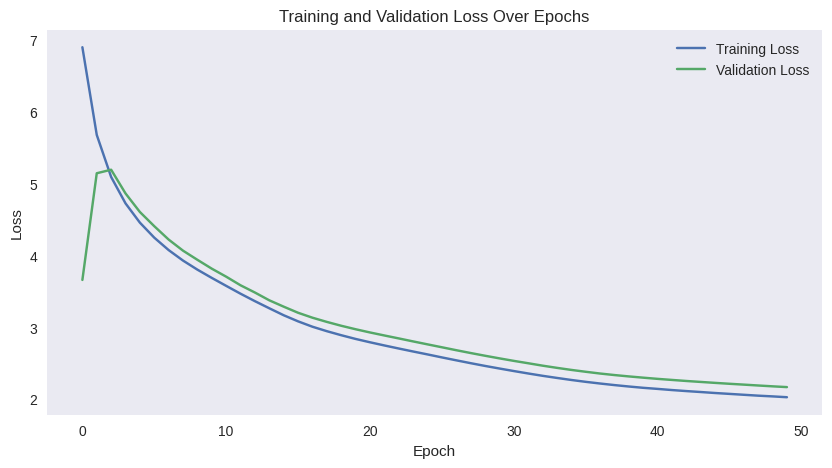

In [ ]:
# TODO: Plot training and validation loss over epochs
plt.figure(figsize=(10, 5))
plt.plot(train_losses, label='Training Loss')
plt.plot(val_losses, label='Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Training and Validation Loss Over Epochs')
plt.legend()
plt.grid()
plt.show()


# # Plot training and validation loss over epochs
# plt.figure(figsize=(10, 5))
# plt.plot(train_losses, label='Train Loss')
# plt.plot(val_losses, label='Val Loss')
# plt.xlabel('Epochs')
# plt.ylabel('Loss')
# plt.title('Training and Validation Loss')
# plt.legend()
# plt.show()


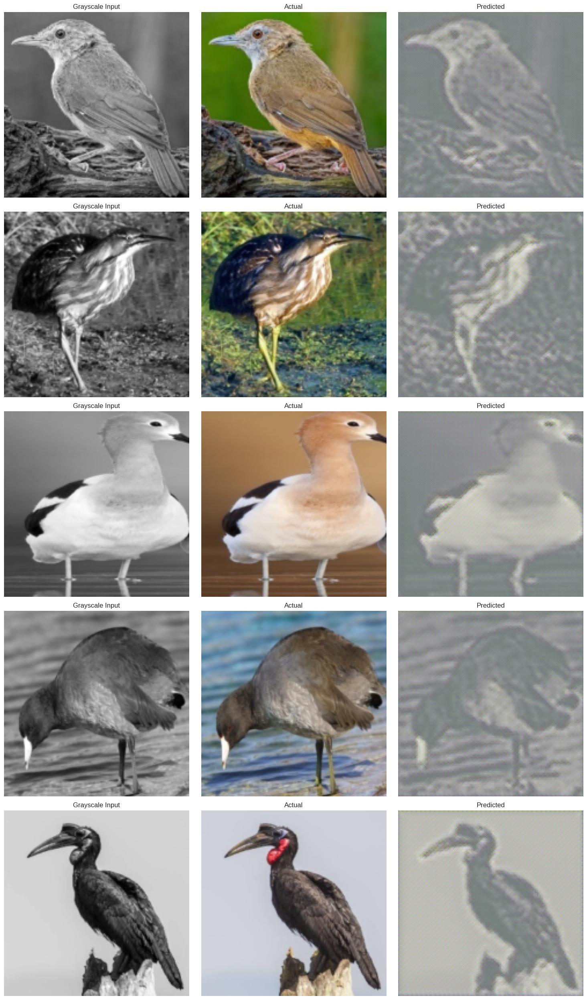

In [ ]:
# TODO: Plot grayscale, actual, and predicted inputs
def plot_images(grayscale, actual, predicted, num_images=5):
    """Plots grayscale inputs, actual images, and predicted outputs."""
    # Limit the number of images to the batch size
    num_images = min(num_images, grayscale.shape[0])

    fig, axes = plt.subplots(num_images, 3, figsize=(15, 5 * num_images))
    axes = axes.flatten()

    for i in range(num_images):
        # Map values from [-1, 1] to [0, 1]
        actual_img = ((actual[i].permute(1, 2, 0).numpy() + 1) / 2).clip(0, 1)
        predicted_img = ((predicted[i].permute(1, 2, 0).numpy() + 1) / 2).clip(0, 1)

        # Grayscale images (still between 0 and 1 for proper visualization)
        grayscale_img = grayscale[i].squeeze(0).numpy()

        # Plot grayscale input
        axes[3 * i].imshow(grayscale_img, cmap='gray')
        axes[3 * i].set_title('Grayscale Input')
        axes[3 * i].axis('off')

        # Plot actual color image
        axes[3 * i + 1].imshow(actual_img)
        axes[3 * i + 1].set_title('Actual')
        axes[3 * i + 1].axis('off')

        # Plot predicted color image
        axes[3 * i + 2].imshow(predicted_img)
        axes[3 * i + 2].set_title('Predicted')
        axes[3 * i + 2].axis('off')

    plt.tight_layout()
    plt.show()

# Get a batch of validation data
model.eval()
with torch.no_grad():
    for batch in val_loader:
        grayscale, color = batch
        grayscale, color = grayscale.to(device), color.to(device)  # Move data to the same device as the model
        predicted = model(grayscale)
        break

grayscale = grayscale.cpu()
color = color.cpu()
predicted = predicted.cpu()

# Plot grayscale, actual, and predicted inputs
plot_images(grayscale, color, predicted)

In [ ]:
# Visualizing the Latent Space
# Latent space visualizations are a powerful tool to understand how the VAE encodes data.
# In this task, students are required to implement a visualization routine to observe the distribution of their data within the latent space.
# The goal is to project high-dimensional encoded data into two dimensions using t-SNE and inspect how different data points are clustered.

import matplotlib.pyplot as plt
from sklearn.manifold import TSNE
import torch

# # Function to visualize the latent space
# def visualize_latent_space(encoder, data_loader, num_samples=1000):
    # """
    # Uses a 2-dimensional t-SNE plot to visualize latent space of encoded images.

    # # TODO: Implement a loop to encode a batch of images and collect their latent representations.
    # # TODO: Use t-SNE to reduce dimensions of these latent representations for visualization.

    # Parameters:
    # encoder (torch.nn.Module): The encoder model component of the VAE.
    # data_loader (torch.utils.data.DataLoader)
    # num_samples (int): Number of samples to visualize
    # """
    # # - Set model to evaluation mode

    # # - Limit the number of samples based on the user's preference

    # # - Move images to the same device as model

    # # TODO: Use the encoder to get the mean (mu) of the latent distribution

    # # - Stack all obtained latent vectors

    # # - t-SNE reduction to 2D for visualization

    # # - Plotting the 2D projection
#     encoder.eval()
#     latent_vectors = []
#     with torch.no_grad():
#         for i, batch in enumerate(data_loader):
#             if i * batch.size(0) >= num_samples:
#                 break
#             batch = batch.to(device)
#             grayscale, color, label = batch
#             mu = encoder(grayscale)
#             latent_vectors.append(mu.cpu().numpy())

#     latent_vectors = np.vstack(latent_vectors)
#     tsne = TSNE(n_components=2)
#     latent_2d = tsne.fit_transform(latent_vectors)
#     plt.scatter(latent_2d[:, 0], latent_2d[:, 1])
#     plt.title('Latent Space Visualization')
#     plt.show()
#     ##############################
#     # encoder.eval()
#     # latent_vectors, labels = [], []
#     # with torch.no_grad():
#     #     for batch in data_loader:
#     #         x, y = batch
#     #         mu, _ = encoder(x)
#     #         latent_vectors.append(mu)
#     #         labels.append(y)
#     #         if len(latent_vectors) * len(x) >= num_samples:
#     #             break

#     # latent_vectors = torch.cat(latent_vectors).cpu().numpy()
#     # labels = torch.cat(labels).cpu().numpy()
#     # tsne = TSNE(n_components=2)
#     # reduced = tsne.fit_transform(latent_vectors)

#     # plt.figure(figsize=(8, 8))
#     # scatter = plt.scatter(reduced[:, 0], reduced[:, 1], c=labels, cmap='viridis', s=5)
#     # plt.colorbar(scatter)
#     # plt.title("Latent Space Visualization")
#     # plt.show()


# # TODO: Use visualize_latent_space function post-training to observe the latent space
# visualize_latent_space(model.encoder, val_loader)



# def visualize_latent_space(encoder, data_loader, num_samples=1000):
#     encoder.eval()
#     latent_vectors = []
#     labels = []

#     with torch.no_grad():
#         for batch in data_loader:
#             grayscale, _ = batch
#             grayscale = grayscale.to(device)
#             encoded = encoder(grayscale)
#             latent_vectors.append(encoded.cpu().numpy())
#             labels.append(batch[1].numpy())
#             if len(latent_vectors) * batch[0].size(0) >= num_samples:
#                 break

#     latent_vectors = np.vstack(latent_vectors)
#     labels = np.concatenate(labels)

#     tsne = TSNE(n_components=2, random_state=42)
#     latent_2d = tsne.fit_transform(latent_vectors)

#     plt.figure(figsize=(10, 8))
#     scatter = plt.scatter(latent_2d[:, 0], latent_2d[:, 1], c=labels, cmap='viridis', alpha=0.6)
#     plt.colorbar(scatter)
#     plt.title('t-SNE projection of the latent space')
#     plt.xlabel('t-SNE feature 1')
#     plt.ylabel('t-SNE feature 2')
#     plt.show()

# # Use visualize_latent_space function post-training to observe the latent space
# visualize_latent_space(model.encoder, val_loader)

import numpy as np
import matplotlib.pyplot as plt
from sklearn.manifold import TSNE
import torch

def visualize_latent_space(encoder, data_loader, num_samples=1000):
    """
    Visualizes the latent space using t-SNE.

    Parameters:
    encoder (torch.nn.Module): The encoder model.
    data_loader (torch.utils.data.DataLoader): Data loader for input data.
    num_samples (int): Number of samples to visualize.
    """
    encoder.eval()
    device = next(encoder.parameters()).device  # Get the device of the model
    latent_vectors = []
    labels = []

    with torch.no_grad():
        for batch in data_loader:
            grayscale, label = batch
            grayscale = grayscale.to(device)

            # Get latent vectors from the encoder
            encoded = encoder(grayscale)

            # Flatten the latent vector to 2D (e.g., [batch_size, latent_dim])
            flattened_latent = encoded.view(encoded.size(0), -1)
            latent_vectors.append(flattened_latent.cpu().numpy())
            labels.append(label.numpy())

            # Stop if we have enough samples
            if sum(len(v) for v in latent_vectors) >= num_samples:
                break

    # Concatenate all latent vectors and labels
    latent_vectors = np.vstack(latent_vectors)
    labels = np.concatenate(labels)

    # Use only the required number of samples
    latent_vectors = latent_vectors[:num_samples]
    labels = labels[:num_samples]

    # Apply t-SNE for dimensionality reduction
    tsne = TSNE(n_components=2, random_state=42)
    latent_2d = tsne.fit_transform(latent_vectors)

    # Plot the t-SNE results
    plt.figure(figsize=(10, 8))
    scatter = plt.scatter(latent_2d[:, 0], latent_2d[:, 1], c=labels, cmap='viridis', alpha=0.6)
    plt.colorbar(scatter, label="Labels")
    plt.title('t-SNE projection of the latent space')
    plt.xlabel('t-SNE feature 1')
    plt.ylabel('t-SNE feature 2')
    plt.show()

# Visualize the latent space
visualize_latent_space(model.encoder, val_loader, num_samples=1000)
# کارت گرافیک کرش کرد اینجا :)

How the distribution of points in the latent space reflects the VAE's capability to generalize grayscale images into colored outputs.

1. **Clustering and Class Representation**:
    - Can you identify clusters in the latent space that correspond to specific image features or categories?
    
    Clusters in the latent space can correspond to specific image features or categories. For example, images with similar color patterns may cluster together.

    - How do these clusters inform us about the VAE's ability to differentiate between various input characteristics related to color information?
    
    These clusters inform us about the VAE's ability to differentiate between various input characteristics related to color information. If clusters are well-separated, it indicates that the VAE has learned meaningful representations.

2. **Continuity and Transitions**:
    - Analyze whether neighboring points in the latent space result in similar or different color outputs. What does this continuity suggest about the latent representation's smoothness?

    Neighboring points in the latent space resulting in similar color outputs suggest that the latent representation is smooth.

    - How could these visual transitions impact the quality and realism of the generated colorations, especially for input images that exhibit gradual changes (e.g., transitions in lighting or shading)?

    This continuity impacts the quality and realism of the generated colorations, especially for input images that exhibit gradual changes (e.g., transitions in lighting or shading). Smooth transitions in the latent space can lead to more natural and realistic colorizations.

3. **Effectiveness of Dimensionality Reduction**:
    - Assess the effectiveness of t-SNE in projecting high-dimensional latent vectors into a comprehensible 2D representation. What limitations might exist, and how do they affect your interpretation?
        - t-SNE is effective in projecting high-dimensional latent vectors into a comprehensible 2D representation. However, it may not preserve all the distances and relationships between points, which can affect interpretation.
        - Limitations include the potential loss of information and the sensitivity to hyperparameters, which can affect the visualization.


Elaborate on how the encoder-decoder architecture facilitates the learning of complex data distributions in image colorization. How does this architecture differ from a simple autoencoder?

The encoder-decoder architecture facilitates the learning of complex data distributions in image colorization by compressing the input into a lower-dimensional latent space and then reconstructing the output from this space. This architecture differs from a simple autoencoder in that it includes a probabilistic component, allowing for the generation of diverse outputs.

Analyze the role of perceptual loss in enhancing the quality of colorized images. How does perceptual loss measure image similarity compared to pixel-wise losses like Mean Squared Error (MSE)?

Perceptual loss enhances the quality of colorized images by measuring image similarity at a higher level of abstraction compared to pixel-wise losses like MSE. It captures the perceptual differences between images, leading to more visually appealing results.

Discuss how the latent space in a VAE impacts the fidelity and diversity of generated color images. What effects could varying the dimensionality of the latent space have?

The latent space in a VAE impacts the fidelity and diversity of generated color images. Varying the dimensionality of the latent space can affect the model's ability to capture complex patterns and generate diverse outputs. A higher-dimensional latent space can capture more details but may be harder to interpret and visualize.

# Image Segmentation with U-Net
Image segmentation is a crucial task in computer vision aimed at dividing an image into meaningful segments or objects. The U-Net architecture, famed for its utility in medical imaging, excels at this by leveraging its encoder-decoder structure, which efficiently learns and reconstructs image details. In this task, the U-Net is trained on pairs of images and masks, enabling it to delineate object boundaries at the pixel level with high precision. The training process involves preprocessing the data, adjusting network parameters, and evaluating the model using metrics like Intersection over Union (IoU) to ensure effective segmentation. Successful implementation of U-Net for this purpose can revolutionize applications in areas like autonomous vehicles, medical diagnosis, and agricultural monitoring.

Dataset: https://drive.google.com/drive/folders/1g97fGNQ6buixT8Hp96QyEYOMNKby5Oe8?usp=sharing

## Importing necessary libraries

In [ ]:
# import system libs
import os
import time
import glob
import shutil

# import data handling tools
import cv2
import PIL
import numpy as np
import pandas as pd
import seaborn as sns
sns.set_style('darkgrid')
import matplotlib.pyplot as plt
# import necessary PyTorch libraries
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
from tqdm import tqdm
import torch.nn.functional as F
print ('modules loaded')

modules loaded


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
device = 'cuda' if torch.cuda.is_available() else 'cpu'
device

'cuda'

## Load the Dataset

array([[  0,   0,   0, ...,   0,   0,   0],
       [  0,   0,   0, ...,   0,   0,   0],
       [  0,   0,   0, ...,   0,   0,   0],
       ...,
       [255, 255, 255, ...,  46,  70,  69],
       [255, 255, 255, ..., 210, 221, 119],
       [248, 255, 255, ..., 255, 255, 121]], dtype=uint8)
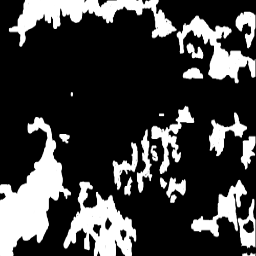

In [ ]:
image_path = "/content/drive/MyDrive/seg_archive/Mask/1.png"
mask = True
image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE if mask else cv2.IMREAD_COLOR)
image = cv2.resize(image, (256, 256))
image

array([[[ 78, 111, 136],
        [102, 128, 169],
        [104, 122, 186],
        ...,
        [ 72,  94,  89],
        [ 77,  99,  96],
        [ 91, 110, 109]],

       [[ 68,  99, 117],
        [ 87, 115, 145],
        [101, 123, 173],
        ...,
        [ 73,  93,  91],
        [ 68,  89,  86],
        [ 82, 103, 104]],

       [[ 78, 109, 118],
        [ 87, 118, 135],
        [ 85, 111, 146],
        ...,
        [ 71,  92,  90],
        [ 77, 100,  98],
        [ 62,  85,  86]],

       ...,

       [[122, 188, 241],
        [120, 187, 241],
        [122, 188, 241],
        ...,
        [ 65,  97, 115],
        [ 55,  92, 113],
        [ 90, 143, 172]],

       [[122, 188, 241],
        [121, 188, 241],
        [122, 188, 241],
        ...,
        [138, 198, 235],
        [113, 177, 218],
        [126, 197, 240]],

       [[121, 187, 239],
        [120, 187, 241],
        [122, 188, 241],
        ...,
        [155, 210, 251],
        [140, 202, 247],
        [136, 203, 251]]], dtype=uint8)
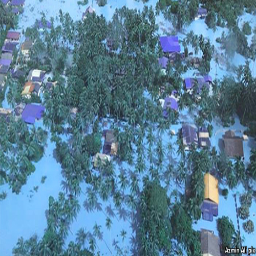

In [ ]:
image_path = "/content/drive/MyDrive/seg_archive/Image/1.jpg"
mask = False
image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE if mask else cv2.IMREAD_COLOR)
image = cv2.resize(image, (256, 256))
image

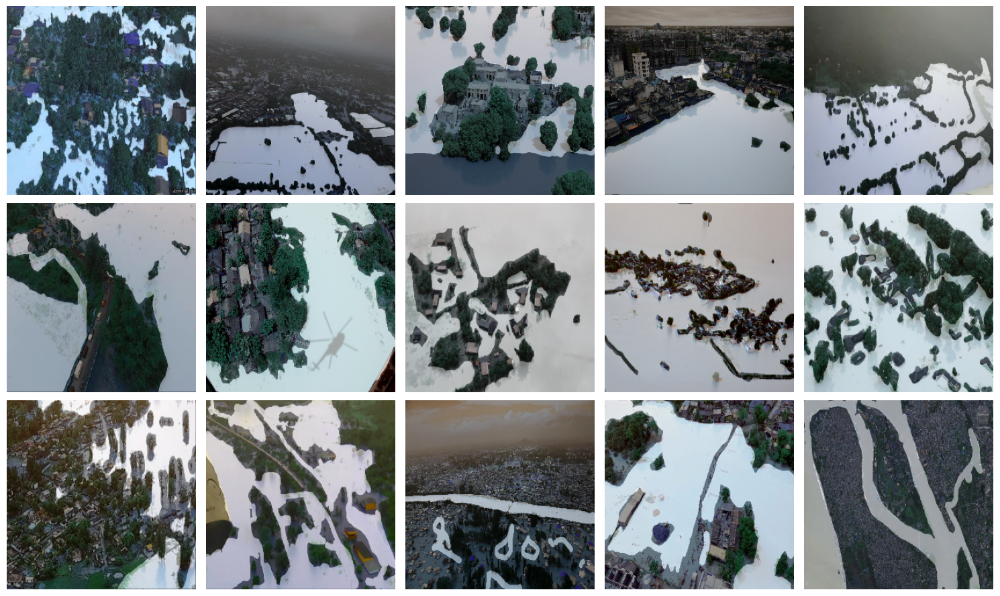

In [ ]:
def create_data(data_dir):
    """
    TODO: Traverse through the given data directory to extract and return paths to images and masks.
    - Identify relevant folders for images and masks.
    - Collect file paths from these folders and return them as lists.
    """
    # pass
    image_dir = os.path.join(data_dir, 'Image')
    mask_dir = os.path.join(data_dir, 'Mask')

    image_paths = sorted(glob.glob(os.path.join(image_dir, '*.jpg')))
    mask_paths = sorted(glob.glob(os.path.join(mask_dir, '*.png')))

    # /content/drive/MyDrive/seg_archive/Image/0.jpg does not load is None
    image_paths.remove('/content/drive/MyDrive/seg_archive/Image/0.jpg')
    mask_paths.remove('/content/drive/MyDrive/seg_archive/Mask/0.png')

    return image_paths, mask_paths

# def load_image(image, SIZE):
#     """
#     TODO: Load and resize an individual image to the specified size, scaling pixel values appropriately.
#     - Convert image to array and normalize pixel values.
#     - Use resizing techniques to ensure uniform image dimensions.
#     """
#     # pass
#     image = cv2.imread(image)
#     # image = cv2.imread(image_path, cv2.IMREAD_COLOR)
#     image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
#     image = cv2.resize(image, (SIZE, SIZE))
#     image = image / 255.0
#     return image
def load_image(image_path, SIZE, mask=False):
    """
    TODO: Load and resize an individual image to the specified size, scaling pixel values appropriately.
    - Convert image to array and normalize pixel values.
    - Use resizing techniques to ensure uniform image dimensions.
    """
    image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE if mask else cv2.IMREAD_COLOR)
    image = cv2.resize(image, (SIZE, SIZE))
    # if not mask:
    #     image = image / 255.0  # Normalize to [0, 1]
    image = image / 255.0
    return image

def load_images(image_paths, SIZE, mask=False, trim=None):
    """
    TODO: Batch process a list of image paths, loading and organizing images into a numpy array.
    - Handle both image and mask files optionally, managing different channel dimensions.
    - Optionally trim the list of images to handle a subset of data.
    """
    # pass
    images = []
    if trim:
        image_paths = image_paths[:trim]
    for path in image_paths:
        image = load_image(path, SIZE, mask)
        images.append(image)
    images = np.array(images)
    if not mask:
        images = np.expand_dims(images, axis=-1) if len(images.shape) == 3 else images
    return images

def show_image(image, title=None, cmap=None, alpha=1):
    """
    TODO: Display a single image using matplotlib with options for color map and transparency.
    - Ensure axes are turned off for a cleaner display.
    - Include optional title for context.
    """
    # pass
    plt.figure(figsize=(5, 5))
    plt.imshow(image, cmap=cmap, alpha=alpha)
    plt.axis('off')
    if title:
        plt.title(title)
    plt.show()

def show_mask(image, mask, cmap=None, alpha=0.4):
    """
    TODO: Overlay a mask on an image to visualize segmentation results.
    - Use transparency to allow both mask and image to be visible.
    - Include color mapping to differentiate mask areas.
    """
    # pass
    plt.figure(figsize=(5, 5))
    plt.imshow(image)
    plt.imshow(mask, cmap=cmap, alpha=alpha)
    plt.axis('off')
    plt.show()

def show_images(imgs, msks):
    """
    TODO: Display multiple image-mask pairs to examine the dataset distribution.
    - Randomly select sample pairs of images and masks for visualization.
    - Use subplots to arrange visuals neatly and use tight layout for optimization.
    """
    # pass
    fig, axes = plt.subplots(3, 5, figsize=(15, 9))
    for i, ax in enumerate(axes.flat):
        if i < len(imgs):
            ax.imshow(imgs[i])
            ax.imshow(msks[i], cmap='gray', alpha=0.4)
            ax.axis('off')
    plt.tight_layout()
    plt.show()

SIZE = 256

# TODO: Load and visualize images
image_paths, mask_paths = create_data('/content/drive/MyDrive/seg_archive')
images = load_images(image_paths, SIZE, mask=False, trim=15)
masks = load_images(mask_paths, SIZE, mask=True, trim=15)
show_images(images, masks)

## The Architecture
In addition to U-Net, we are going to utilize Attention Gates.
You probably need to read this paper: https://arxiv.org/pdf/1804.03999v3

In [ ]:
# Define SegmentationDataset class
class SegmentationDataset(Dataset):
    def __init__(self, image_paths, mask_paths, transform=None):
        self.image_paths = image_paths
        self.mask_paths = mask_paths
        self.transform = transform

    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, idx):
        image = cv2.imread(self.image_paths[idx], cv2.IMREAD_COLOR)
        image = cv2.resize(image, (SIZE, SIZE))

        mask = cv2.imread(self.mask_paths[idx], cv2.IMREAD_GRAYSCALE)
        mask = cv2.resize(mask, (SIZE, SIZE))
        mask = torch.tensor(mask > 0, dtype=torch.float32)
        mask = mask.unsqueeze(0) # torch.Size([3, 256, 256]) torch.Size([1, 256, 256])

        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

        if self.transform:
            image = self.transform(image)

        return image, mask

# Define transforms
transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

# Create DataLoader
train_val_division = 0.8 * len(image_paths)
train_val_division = int(train_val_division)

train_dataset = SegmentationDataset(image_paths[:train_val_division], mask_paths[:train_val_division], transform=transform)
val_dataset = SegmentationDataset(image_paths[train_val_division:], mask_paths[train_val_division:], transform=transform)

BATCH_SIZE = 24

train_loader = DataLoader(train_dataset, batch_size=BATCH_SIZE, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=BATCH_SIZE)

for images_batch, masks_batch in train_loader:
    print(f"images_batch.shape: {images_batch.shape}")
    print(f"masks_batch.shape: {masks_batch.shape}")
    break

images_batch.shape: torch.Size([24, 3, 256, 256])
masks_batch.shape: torch.Size([24, 1, 256, 256])


heavier model (بخاطر زمان زیاد مدل سبک تر را ران کردیم)

In [ ]:
# Enhancing U-Net with Dice and Jaccard Losses for Segmentation
class DiceLoss(nn.Module):
    def __init__(self, smooth=1e-6):
        super(DiceLoss, self).__init__()
        self.smooth = smooth

    def forward(self, pred, target):
        pred_flat = pred.view(-1)
        target_flat = target.view(-1)
        intersection = (pred_flat * target_flat).sum()
        return 1 - (2. * intersection + self.smooth) / (pred_flat.sum() + target_flat.sum() + self.smooth)

class JaccardLoss(nn.Module):
    def __init__(self, smooth=1e-6):
        super(JaccardLoss, self).__init__()
        self.smooth = smooth

    def forward(self, pred, target):
        pred_flat = pred.view(-1)
        target_flat = target.view(-1)
        intersection = (pred_flat * target_flat).sum()
        union = pred_flat.sum() + target_flat.sum() - intersection
        return 1 - (intersection + self.smooth) / (union + self.smooth)

class EncoderBlock(nn.Module):
    def __init__(self, in_filters, out_filters, dropout_rate=0.1, pooling=True):
        super(EncoderBlock, self).__init__()
        self.pooling = pooling
        self.conv = nn.Sequential(
            nn.Conv2d(in_filters, out_filters, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            nn.Conv2d(out_filters, out_filters, kernel_size=3, padding=1),
            nn.ReLU(inplace=True)
        )
        self.dropout = nn.Dropout2d(dropout_rate)
        if pooling:
            self.pool = nn.MaxPool2d(kernel_size=2)

    def forward(self, x):
        x = self.conv(x)
        x = self.dropout(x)
        if self.pooling:
            x = self.pool(x)
        return x

class DecoderBlock(nn.Module):
    def __init__(self, skip_channels, in_filters, out_filters, dropout_rate=0.1):
        super(DecoderBlock, self).__init__()
        self.upconv = nn.ConvTranspose2d(in_filters, out_filters, kernel_size=2, stride=2)
        self.conv = nn.Sequential(
            nn.Conv2d(skip_channels + out_filters, out_filters, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            nn.Conv2d(out_filters, out_filters, kernel_size=3, padding=1),
            nn.ReLU(inplace=True)
        )
        self.dropout = nn.Dropout2d(dropout_rate)

    def forward(self, x, skip):
        x = self.upconv(x)
        if x.size() != skip.size():
            # Align spatial dimensions
            diff_h = skip.size(2) - x.size(2)
            diff_w = skip.size(3) - x.size(3)
            x = F.pad(x, [diff_w // 2, diff_w - diff_w // 2, diff_h // 2, diff_h - diff_h // 2])
        x = torch.cat([x, skip], dim=1)  # Concatenate along channel axis
        x = self.conv(x)
        x = self.dropout(x)
        return x

class AttentionGate(nn.Module):
    def __init__(self, in_channels, gating_channels, bn=True):
        super(AttentionGate, self).__init__()
        self.theta_x = nn.Conv2d(in_channels, in_channels // 2, kernel_size=1)
        self.phi_g = nn.Conv2d(gating_channels, in_channels // 2, kernel_size=1)
        self.psi = nn.Conv2d(in_channels // 2, 1, kernel_size=1)
        self.bn = nn.BatchNorm2d(1) if bn else nn.Identity()
        self.sigmoid = nn.Sigmoid()
        self.upsample = nn.Upsample(scale_factor=2, mode='bilinear', align_corners=True)

    def forward(self, x, g):
        theta_x = self.theta_x(x)  # Downscale x
        phi_g = self.phi_g(g)     # Downscale g

        # Align spatial dimensions
        if theta_x.size() != phi_g.size():
            phi_g = self.upsample(phi_g)

        f = torch.relu(theta_x + phi_g)
        psi = self.sigmoid(self.bn(self.psi(f)))
        return x * psi  # Element-wise multiplication

# heavy model with 1 more encoder, decoder (4 encoder in total)
# class UNetModel(nn.Module):
#     def __init__(self, in_filters=3, out_filters=1, dropout_rate=0.1):
#         super(UNetModel, self).__init__()
#         self.conv = nn.Sequential(
#             nn.Conv2d(in_filters, 32, kernel_size=3, padding=1),
#             nn.ReLU(inplace=True),
#             nn.BatchNorm2d(32),
#         )

#         # self.encoder1 = EncoderBlock(in_filters, 64, dropout_rate, pooling=True)
#         self.encoder1 = EncoderBlock(32, 64, dropout_rate, pooling=True)
#         self.encoder2 = EncoderBlock(64, 128, dropout_rate, pooling=True)
#         self.encoder3 = EncoderBlock(128, 256, dropout_rate, pooling=True)
#         self.encoder4 = EncoderBlock(256, 512, dropout_rate, pooling=True)

#         self.bottleneck = EncoderBlock(512, 1024, dropout_rate, pooling=False)

#         self.attention3 = AttentionGate(256, 1024)
#         self.attention2 = AttentionGate(128, 512)
#         self.attention1 = AttentionGate(64, 256)
#         # self.attention0 = AttentionGate(3, 128)
#         self.attention0 = AttentionGate(32, 128)

#         self.decoder3 = DecoderBlock(256, 1024, 512, dropout_rate)  # Skip from encoder3
#         self.decoder2 = DecoderBlock(128, 512, 256, dropout_rate)   # Skip from encoder2
#         self.decoder1 = DecoderBlock(64, 256, 128, dropout_rate)    # Skip from encoder1

#         # Add an additional decoder step for the final upsampling
#         # self.decoder0 = DecoderBlock(3, 128, 64, dropout_rate)
#         self.decoder0 = DecoderBlock(32, 128, 64, dropout_rate)

#         self.final = nn.Conv2d(64, out_filters, kernel_size=1)

#         self.sigmoid = nn.Sigmoid()

#         self.dice_loss = DiceLoss()
#         self.jaccard_loss = JaccardLoss()

#     def forward(self, x):
#         x = self.conv(x)

#         enc1 = self.encoder1(x)
#         enc2 = self.encoder2(enc1)
#         enc3 = self.encoder3(enc2)
#         enc4 = self.encoder4(enc3)

#         bottleneck = self.bottleneck(enc4)

#         dec3 = self.decoder3(bottleneck, self.attention3(enc3, bottleneck))
#         dec2 = self.decoder2(dec3, self.attention2(enc2, dec3))
#         dec1 = self.decoder1(dec2, self.attention1(enc1, dec2))

#         # Final upsampling step
#         # dec0 = self.decoder0(dec1)
#         dec0 = self.decoder0(dec1, self.attention0(x, dec1))

#         out = self.final(dec0)
#         out = self.sigmoid(out)  # Apply sigmoid activation for binary segmentation
#         return out

#     def compute_loss(self, pred, target):
#         dice = self.dice_loss(pred, target)
#         jaccard = self.jaccard_loss(pred, target)
#         return dice + jaccard

# model = UNetModel(dropout_rate=0.5).to(device)


lighter model

In [ ]:
class DiceLoss(nn.Module):
    def __init__(self, smooth=1e-6):
        super(DiceLoss, self).__init__()
        self.smooth = smooth

    def forward(self, pred, target):
        pred_flat = pred.view(-1)
        target_flat = target.view(-1)
        intersection = (pred_flat * target_flat).sum()
        return 1 - (2. * intersection + self.smooth) / (pred_flat.sum() + target_flat.sum() + self.smooth)

class JaccardLoss(nn.Module):
    def __init__(self, smooth=1e-6):
        super(JaccardLoss, self).__init__()
        self.smooth = smooth

    def forward(self, pred, target):
        pred_flat = pred.view(-1)
        target_flat = target.view(-1)
        intersection = (pred_flat * target_flat).sum()
        union = pred_flat.sum() + target_flat.sum() - intersection
        return 1 - (intersection + self.smooth) / (union + self.smooth)

class EncoderBlock(nn.Module):
    def __init__(self, in_filters, out_filters, dropout_rate=0.3, pooling=True):
        super(EncoderBlock, self).__init__()
        self.pooling = pooling
        self.conv = nn.Sequential(
            nn.Conv2d(in_filters, out_filters, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            # nn.BatchNorm2d(out_filters),
            nn.Conv2d(out_filters, out_filters, kernel_size=3, padding=1),
            nn.ReLU(inplace=True)
            # nn.BatchNorm2d(out_filters)
        )
        self.dropout = nn.Dropout2d(dropout_rate)
        if pooling:
            self.pool = nn.MaxPool2d(kernel_size=2)

    def forward(self, x):
        x = self.conv(x)
        x = self.dropout(x)
        if self.pooling:
            x = self.pool(x)
        return x

class DecoderBlock(nn.Module):
    def __init__(self, skip_channels, in_filters, out_filters, dropout_rate=0.3):
        super(DecoderBlock, self).__init__()
        self.upconv = nn.ConvTranspose2d(in_filters, out_filters, kernel_size=2, stride=2)
        self.conv = nn.Sequential(
            nn.Conv2d(skip_channels + out_filters, out_filters, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            # nn.BatchNorm2d(out_filters),
            nn.Conv2d(out_filters, out_filters, kernel_size=3, padding=1),
            nn.ReLU(inplace=True)
            # nn.BatchNorm2d(out_filters)
        )
        self.dropout = nn.Dropout2d(dropout_rate)

    def forward(self, x, skip):
        x = self.upconv(x)
        if x.size() != skip.size():
            # Align spatial dimensions
            diff_h = skip.size(2) - x.size(2)
            diff_w = skip.size(3) - x.size(3)
            x = F.pad(x, [diff_w // 2, diff_w - diff_w // 2, diff_h // 2, diff_h - diff_h // 2])
        x = torch.cat([x, skip], dim=1)  # Concatenate along channel axis
        x = self.conv(x)
        x = self.dropout(x)
        return x

class AttentionGate(nn.Module):
    def __init__(self, in_channels, gating_channels, bn=True):
        super(AttentionGate, self).__init__()
        self.theta_x = nn.Conv2d(in_channels, in_channels // 2, kernel_size=1)
        self.phi_g = nn.Conv2d(gating_channels, in_channels // 2, kernel_size=1)
        self.psi = nn.Conv2d(in_channels // 2, 1, kernel_size=1)
        self.bn = nn.BatchNorm2d(1) if bn else nn.Identity()
        self.sigmoid = nn.Sigmoid()
        self.upsample = nn.Upsample(scale_factor=2, mode='bilinear', align_corners=True)

    def forward(self, x, g):
        theta_x = self.theta_x(x)  # Downscale x
        phi_g = self.phi_g(g)     # Downscale g

        # Align spatial dimensions
        if theta_x.size() != phi_g.size():
            phi_g = self.upsample(phi_g)

        f = torch.relu(theta_x + phi_g)
        psi = self.sigmoid(self.bn(self.psi(f)))
        return x * psi  # Element-wise multiplication

# light version for less time (3 encoder in total)
class UNetModel(nn.Module):
    def __init__(self, in_filters=3, out_filters=1, dropout_rate=0.3):
        super(UNetModel, self).__init__()
        self.conv = nn.Sequential(
            nn.Conv2d(in_filters, 32, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            nn.BatchNorm2d(32),
        )

        self.encoder1 = EncoderBlock(32, 64, dropout_rate, pooling=True)
        self.encoder2 = EncoderBlock(64, 128, dropout_rate, pooling=True)
        self.encoder3 = EncoderBlock(128, 256, dropout_rate, pooling=True)

        self.bottleneck = EncoderBlock(256, 512, dropout_rate, pooling=False)

        self.attention2 = AttentionGate(128, 512) # in_channels, gating_channels
        self.attention1 = AttentionGate(64, 256)
        self.attention0 = AttentionGate(32, 128)

        self.decoder2 = DecoderBlock(128, 512, 256, dropout_rate)   # skip_channels, in_filters, out_filters
        self.decoder1 = DecoderBlock(64, 256, 128, dropout_rate)
        self.decoder0 = DecoderBlock(32, 128, 64, dropout_rate)

        self.final = nn.Conv2d(64, out_filters, kernel_size=1)

        self.sigmoid = nn.Sigmoid()

        self.dice_loss = DiceLoss()
        self.jaccard_loss = JaccardLoss()

    def forward(self, x):
        x = self.conv(x)

        enc1 = self.encoder1(x)
        enc2 = self.encoder2(enc1)
        enc3 = self.encoder3(enc2)

        bottleneck = self.bottleneck(enc3)

        dec2 = self.decoder2(bottleneck, self.attention2(enc2, bottleneck))
        dec1 = self.decoder1(dec2, self.attention1(enc1, dec2))
        dec0 = self.decoder0(dec1, self.attention0(x, dec1))

        out = self.final(dec0)

        out = self.sigmoid(out)  # Apply sigmoid activation for binary segmentation

        return out

    def compute_loss(self, pred, target):
        dice = self.dice_loss(pred, target)
        jaccard = self.jaccard_loss(pred, target)
        return dice + jaccard

# بخطار کمبود زمان از مدل سبک تر استفاده کردیم اگر از مدل قوی تر استفاده میکردیم احتمالا نتیجه بهتری میگرفتیم
model = UNetModel(dropout_rate=0.5).to(device)

In [ ]:
for images_batch, masks_batch in train_loader:
    outputs = model(images_batch.to(device))
    break

print(f"Model output shape: {outputs.shape}")  # Should be [batch_size, 1, 256, 256]

Model output shape: torch.Size([24, 1, 256, 256])


## Training

In [ ]:
# TODOL:
# set batch size for training
# number of all epochs in training
# number of epochs to run before asking if you want to halt training

# Training
num_epochs = 100
checkpoint_epochs = 10

best_val_loss = float('inf')
best_val_loss_epoch = -1
best_val_accuracy = 0.0
best_val_accuracy_epoch = -1


# Define the loss function and optimizer
criterion = model.compute_loss
optimizer = optim.Adam(model.parameters(), lr=1e-4)

# Function to calculate accuracy
def calculate_accuracy(outputs, masks, threshold=0.5):
    predictions = (outputs > threshold).float()
    correct = (predictions == masks).float().sum()
    total = masks.numel()
    accuracy = correct / total
    return accuracy

train_losses = []
val_losses = []
train_accuracies = []
val_accuracies = []

for epoch in range(num_epochs):
    # Training loop
    model.train()
    running_loss = 0.0
    running_accuracy = 0.0
    for images, masks in tqdm(train_loader, desc=f"Epoch {epoch+1}/{num_epochs}"):
        images = images.to(device)
        masks = masks.to(device)

        optimizer.zero_grad()
        outputs = model(images)
        # print(outputs.shape)
        # print(masks.shape)
        loss = criterion(outputs, masks)
        loss.backward()
        optimizer.step()

        running_loss += loss.item()
        running_accuracy += calculate_accuracy(outputs, masks)

    train_loss = running_loss / len(train_loader)
    train_accuracy = running_accuracy / len(train_loader)
    train_losses.append(train_loss)
    train_accuracies.append(train_accuracy)

    # Validation loop
    model.eval()
    val_running_loss = 0.0
    val_running_accuracy = 0.0
    with torch.no_grad():
        for images, masks in val_loader:
            images = images.to(device)
            masks = masks.to(device)

            outputs = model(images)
            loss = criterion(outputs, masks)
            val_running_loss += loss.item()
            val_running_accuracy += calculate_accuracy(outputs, masks)

    val_loss = val_running_loss / len(val_loader)
    val_accuracy = val_running_accuracy / len(val_loader)
    val_losses.append(val_loss)
    val_accuracies.append(val_accuracy)

    if val_loss < best_val_loss:
        best_val_loss = val_loss
        best_val_loss_epoch = epoch + 1  # Epoch numbers are 1-based

    if val_accuracy > best_val_accuracy:
        best_val_accuracy = val_accuracy
        best_val_accuracy_epoch = epoch + 1  # Epoch numbers are 1-based


    print(f"Epoch {epoch+1}/{num_epochs}, Train Loss: {train_loss:.4f}, Train Accuracy: {train_accuracy:.4f}, Val Loss: {val_loss:.4f}, Val Accuracy: {val_accuracy:.4f}")

    # Checkpoint
    if (epoch + 1) % checkpoint_epochs == 0:
        torch.save(model.state_dict(), f'unet_model_epoch_{epoch+1}.pth')


Epoch 1/100: 100%|██████████| 10/10 [00:18<00:00,  1.85s/it]


Epoch 1/100, Train Loss: 1.2167, Train Accuracy: 0.5886, Val Loss: 1.3000, Val Accuracy: 0.6660


Epoch 2/100: 100%|██████████| 10/10 [00:17<00:00,  1.75s/it]


Epoch 2/100, Train Loss: 1.1891, Train Accuracy: 0.6587, Val Loss: 1.2524, Val Accuracy: 0.6962


Epoch 3/100: 100%|██████████| 10/10 [00:17<00:00,  1.79s/it]


Epoch 3/100, Train Loss: 1.0943, Train Accuracy: 0.6583, Val Loss: 1.1658, Val Accuracy: 0.3773


Epoch 4/100: 100%|██████████| 10/10 [00:17<00:00,  1.75s/it]


Epoch 4/100, Train Loss: 0.9521, Train Accuracy: 0.4553, Val Loss: 1.1029, Val Accuracy: 0.3755


Epoch 5/100: 100%|██████████| 10/10 [00:17<00:00,  1.77s/it]


Epoch 5/100, Train Loss: 0.8981, Train Accuracy: 0.5705, Val Loss: 0.8554, Val Accuracy: 0.7161


Epoch 6/100: 100%|██████████| 10/10 [00:17<00:00,  1.75s/it]


Epoch 6/100, Train Loss: 0.8148, Train Accuracy: 0.6605, Val Loss: 0.8380, Val Accuracy: 0.6748


Epoch 7/100: 100%|██████████| 10/10 [00:18<00:00,  1.84s/it]


Epoch 7/100, Train Loss: 0.7919, Train Accuracy: 0.6620, Val Loss: 0.7887, Val Accuracy: 0.7184


Epoch 8/100: 100%|██████████| 10/10 [00:17<00:00,  1.77s/it]


Epoch 8/100, Train Loss: 0.7643, Train Accuracy: 0.6874, Val Loss: 0.7830, Val Accuracy: 0.7131


Epoch 9/100: 100%|██████████| 10/10 [00:17<00:00,  1.76s/it]


Epoch 9/100, Train Loss: 0.7537, Train Accuracy: 0.6841, Val Loss: 0.7669, Val Accuracy: 0.7234


Epoch 10/100: 100%|██████████| 10/10 [00:17<00:00,  1.77s/it]


Epoch 10/100, Train Loss: 0.7349, Train Accuracy: 0.7012, Val Loss: 0.7476, Val Accuracy: 0.7371


Epoch 11/100: 100%|██████████| 10/10 [00:17<00:00,  1.77s/it]


Epoch 11/100, Train Loss: 0.7224, Train Accuracy: 0.7086, Val Loss: 0.7332, Val Accuracy: 0.7415


Epoch 12/100: 100%|██████████| 10/10 [00:17<00:00,  1.77s/it]


Epoch 12/100, Train Loss: 0.6930, Train Accuracy: 0.7217, Val Loss: 0.7124, Val Accuracy: 0.7508


Epoch 13/100: 100%|██████████| 10/10 [00:23<00:00,  2.36s/it]


Epoch 13/100, Train Loss: 0.6749, Train Accuracy: 0.7381, Val Loss: 0.6850, Val Accuracy: 0.7660


Epoch 14/100: 100%|██████████| 10/10 [00:18<00:00,  1.81s/it]


Epoch 14/100, Train Loss: 0.6436, Train Accuracy: 0.7564, Val Loss: 0.6424, Val Accuracy: 0.7932


Epoch 15/100: 100%|██████████| 10/10 [00:18<00:00,  1.90s/it]


Epoch 15/100, Train Loss: 0.6102, Train Accuracy: 0.7807, Val Loss: 0.6007, Val Accuracy: 0.8176


Epoch 16/100: 100%|██████████| 10/10 [00:18<00:00,  1.81s/it]


Epoch 16/100, Train Loss: 0.5751, Train Accuracy: 0.8020, Val Loss: 0.5662, Val Accuracy: 0.8363


Epoch 17/100: 100%|██████████| 10/10 [00:18<00:00,  1.89s/it]


Epoch 17/100, Train Loss: 0.5617, Train Accuracy: 0.8064, Val Loss: 0.5429, Val Accuracy: 0.8491


Epoch 18/100: 100%|██████████| 10/10 [00:18<00:00,  1.82s/it]


Epoch 18/100, Train Loss: 0.5360, Train Accuracy: 0.8255, Val Loss: 0.5587, Val Accuracy: 0.8373


Epoch 19/100: 100%|██████████| 10/10 [00:18<00:00,  1.84s/it]


Epoch 19/100, Train Loss: 0.5613, Train Accuracy: 0.8052, Val Loss: 0.5168, Val Accuracy: 0.8582


Epoch 20/100: 100%|██████████| 10/10 [00:18<00:00,  1.86s/it]


Epoch 20/100, Train Loss: 0.5306, Train Accuracy: 0.8265, Val Loss: 0.5157, Val Accuracy: 0.8575


Epoch 21/100: 100%|██████████| 10/10 [00:19<00:00,  1.96s/it]


Epoch 21/100, Train Loss: 0.5429, Train Accuracy: 0.8196, Val Loss: 0.5244, Val Accuracy: 0.8520


Epoch 22/100: 100%|██████████| 10/10 [00:19<00:00,  1.96s/it]


Epoch 22/100, Train Loss: 0.5464, Train Accuracy: 0.8193, Val Loss: 0.5370, Val Accuracy: 0.8462


Epoch 23/100: 100%|██████████| 10/10 [00:19<00:00,  1.93s/it]


Epoch 23/100, Train Loss: 0.5202, Train Accuracy: 0.8240, Val Loss: 0.5136, Val Accuracy: 0.8607


Epoch 24/100: 100%|██████████| 10/10 [00:18<00:00,  1.86s/it]


Epoch 24/100, Train Loss: 0.5278, Train Accuracy: 0.8303, Val Loss: 0.5226, Val Accuracy: 0.8520


Epoch 25/100: 100%|██████████| 10/10 [00:17<00:00,  1.79s/it]


Epoch 25/100, Train Loss: 0.5273, Train Accuracy: 0.8206, Val Loss: 0.5220, Val Accuracy: 0.8555


Epoch 26/100: 100%|██████████| 10/10 [00:19<00:00,  1.94s/it]


Epoch 26/100, Train Loss: 0.5227, Train Accuracy: 0.8303, Val Loss: 0.5085, Val Accuracy: 0.8610


Epoch 27/100: 100%|██████████| 10/10 [00:18<00:00,  1.82s/it]


Epoch 27/100, Train Loss: 0.5080, Train Accuracy: 0.8300, Val Loss: 0.5031, Val Accuracy: 0.8633


Epoch 28/100: 100%|██████████| 10/10 [00:18<00:00,  1.85s/it]


Epoch 28/100, Train Loss: 0.5233, Train Accuracy: 0.8262, Val Loss: 0.5032, Val Accuracy: 0.8609


Epoch 29/100: 100%|██████████| 10/10 [00:17<00:00,  1.77s/it]


Epoch 29/100, Train Loss: 0.5076, Train Accuracy: 0.8348, Val Loss: 0.4983, Val Accuracy: 0.8662


Epoch 30/100: 100%|██████████| 10/10 [00:17<00:00,  1.78s/it]


Epoch 30/100, Train Loss: 0.5160, Train Accuracy: 0.8316, Val Loss: 0.4882, Val Accuracy: 0.8682


Epoch 31/100: 100%|██████████| 10/10 [00:17<00:00,  1.76s/it]


Epoch 31/100, Train Loss: 0.5056, Train Accuracy: 0.8354, Val Loss: 0.4892, Val Accuracy: 0.8682


Epoch 32/100: 100%|██████████| 10/10 [00:17<00:00,  1.77s/it]


Epoch 32/100, Train Loss: 0.4961, Train Accuracy: 0.8369, Val Loss: 0.5019, Val Accuracy: 0.8644


Epoch 33/100: 100%|██████████| 10/10 [00:17<00:00,  1.76s/it]


Epoch 33/100, Train Loss: 0.4943, Train Accuracy: 0.8398, Val Loss: 0.5028, Val Accuracy: 0.8636


Epoch 34/100: 100%|██████████| 10/10 [00:18<00:00,  1.89s/it]


Epoch 34/100, Train Loss: 0.4998, Train Accuracy: 0.8348, Val Loss: 0.4945, Val Accuracy: 0.8649


Epoch 35/100: 100%|██████████| 10/10 [00:17<00:00,  1.74s/it]


Epoch 35/100, Train Loss: 0.4900, Train Accuracy: 0.8419, Val Loss: 0.4785, Val Accuracy: 0.8746


Epoch 36/100: 100%|██████████| 10/10 [00:17<00:00,  1.78s/it]


Epoch 36/100, Train Loss: 0.5042, Train Accuracy: 0.8331, Val Loss: 0.4781, Val Accuracy: 0.8730


Epoch 37/100: 100%|██████████| 10/10 [00:18<00:00,  1.81s/it]


Epoch 37/100, Train Loss: 0.4824, Train Accuracy: 0.8443, Val Loss: 0.4797, Val Accuracy: 0.8712


Epoch 38/100: 100%|██████████| 10/10 [00:17<00:00,  1.78s/it]


Epoch 38/100, Train Loss: 0.4960, Train Accuracy: 0.8369, Val Loss: 0.4857, Val Accuracy: 0.8729


Epoch 39/100: 100%|██████████| 10/10 [00:17<00:00,  1.75s/it]


Epoch 39/100, Train Loss: 0.4884, Train Accuracy: 0.8443, Val Loss: 0.4789, Val Accuracy: 0.8702


Epoch 40/100: 100%|██████████| 10/10 [00:18<00:00,  1.86s/it]


Epoch 40/100, Train Loss: 0.4938, Train Accuracy: 0.8390, Val Loss: 0.4819, Val Accuracy: 0.8684


Epoch 41/100: 100%|██████████| 10/10 [00:18<00:00,  1.80s/it]


Epoch 41/100, Train Loss: 0.4821, Train Accuracy: 0.8399, Val Loss: 0.4792, Val Accuracy: 0.8693


Epoch 42/100: 100%|██████████| 10/10 [00:17<00:00,  1.78s/it]


Epoch 42/100, Train Loss: 0.4729, Train Accuracy: 0.8480, Val Loss: 0.4702, Val Accuracy: 0.8735


Epoch 43/100: 100%|██████████| 10/10 [00:17<00:00,  1.76s/it]


Epoch 43/100, Train Loss: 0.4717, Train Accuracy: 0.8468, Val Loss: 0.4677, Val Accuracy: 0.8757


Epoch 44/100: 100%|██████████| 10/10 [00:18<00:00,  1.85s/it]


Epoch 44/100, Train Loss: 0.4958, Train Accuracy: 0.8394, Val Loss: 0.4862, Val Accuracy: 0.8652


Epoch 45/100: 100%|██████████| 10/10 [00:17<00:00,  1.77s/it]


Epoch 45/100, Train Loss: 0.4760, Train Accuracy: 0.8439, Val Loss: 0.4620, Val Accuracy: 0.8767


Epoch 46/100: 100%|██████████| 10/10 [00:19<00:00,  1.98s/it]


Epoch 46/100, Train Loss: 0.4751, Train Accuracy: 0.8481, Val Loss: 0.4742, Val Accuracy: 0.8694


Epoch 47/100: 100%|██████████| 10/10 [00:17<00:00,  1.77s/it]


Epoch 47/100, Train Loss: 0.4860, Train Accuracy: 0.8397, Val Loss: 0.4783, Val Accuracy: 0.8697


Epoch 48/100: 100%|██████████| 10/10 [00:17<00:00,  1.77s/it]


Epoch 48/100, Train Loss: 0.4819, Train Accuracy: 0.8457, Val Loss: 0.4706, Val Accuracy: 0.8738


Epoch 49/100: 100%|██████████| 10/10 [00:17<00:00,  1.78s/it]


Epoch 49/100, Train Loss: 0.4843, Train Accuracy: 0.8393, Val Loss: 0.4637, Val Accuracy: 0.8743


Epoch 50/100: 100%|██████████| 10/10 [00:18<00:00,  1.88s/it]


Epoch 50/100, Train Loss: 0.4894, Train Accuracy: 0.8445, Val Loss: 0.4702, Val Accuracy: 0.8730


Epoch 51/100: 100%|██████████| 10/10 [00:17<00:00,  1.78s/it]


Epoch 51/100, Train Loss: 0.4806, Train Accuracy: 0.8437, Val Loss: 0.4817, Val Accuracy: 0.8663


Epoch 52/100: 100%|██████████| 10/10 [00:18<00:00,  1.80s/it]


Epoch 52/100, Train Loss: 0.4676, Train Accuracy: 0.8489, Val Loss: 0.4726, Val Accuracy: 0.8711


Epoch 53/100: 100%|██████████| 10/10 [00:17<00:00,  1.77s/it]


Epoch 53/100, Train Loss: 0.4776, Train Accuracy: 0.8452, Val Loss: 0.4628, Val Accuracy: 0.8764


Epoch 54/100: 100%|██████████| 10/10 [00:17<00:00,  1.77s/it]


Epoch 54/100, Train Loss: 0.4637, Train Accuracy: 0.8495, Val Loss: 0.4576, Val Accuracy: 0.8767


Epoch 55/100: 100%|██████████| 10/10 [00:18<00:00,  1.86s/it]


Epoch 55/100, Train Loss: 0.4756, Train Accuracy: 0.8450, Val Loss: 0.4769, Val Accuracy: 0.8692


Epoch 56/100: 100%|██████████| 10/10 [00:19<00:00,  1.96s/it]


Epoch 56/100, Train Loss: 0.4698, Train Accuracy: 0.8479, Val Loss: 0.4689, Val Accuracy: 0.8719


Epoch 57/100: 100%|██████████| 10/10 [00:18<00:00,  1.84s/it]


Epoch 57/100, Train Loss: 0.4628, Train Accuracy: 0.8514, Val Loss: 0.4648, Val Accuracy: 0.8750


Epoch 58/100: 100%|██████████| 10/10 [00:17<00:00,  1.76s/it]


Epoch 58/100, Train Loss: 0.4717, Train Accuracy: 0.8452, Val Loss: 0.4495, Val Accuracy: 0.8809


Epoch 59/100: 100%|██████████| 10/10 [00:18<00:00,  1.81s/it]


Epoch 59/100, Train Loss: 0.4591, Train Accuracy: 0.8552, Val Loss: 0.4583, Val Accuracy: 0.8738


Epoch 60/100: 100%|██████████| 10/10 [00:18<00:00,  1.84s/it]


Epoch 60/100, Train Loss: 0.4596, Train Accuracy: 0.8503, Val Loss: 0.4683, Val Accuracy: 0.8806


Epoch 61/100: 100%|██████████| 10/10 [00:19<00:00,  1.91s/it]


Epoch 61/100, Train Loss: 0.4897, Train Accuracy: 0.8439, Val Loss: 0.4825, Val Accuracy: 0.8626


Epoch 62/100: 100%|██████████| 10/10 [00:17<00:00,  1.76s/it]


Epoch 62/100, Train Loss: 0.4723, Train Accuracy: 0.8450, Val Loss: 0.4423, Val Accuracy: 0.8838


Epoch 63/100: 100%|██████████| 10/10 [00:17<00:00,  1.76s/it]


Epoch 63/100, Train Loss: 0.4647, Train Accuracy: 0.8516, Val Loss: 0.4637, Val Accuracy: 0.8712


Epoch 64/100: 100%|██████████| 10/10 [00:18<00:00,  1.88s/it]


Epoch 64/100, Train Loss: 0.4707, Train Accuracy: 0.8442, Val Loss: 0.4668, Val Accuracy: 0.8760


Epoch 65/100: 100%|██████████| 10/10 [00:17<00:00,  1.78s/it]


Epoch 65/100, Train Loss: 0.4749, Train Accuracy: 0.8489, Val Loss: 0.4654, Val Accuracy: 0.8711


Epoch 66/100: 100%|██████████| 10/10 [00:18<00:00,  1.88s/it]


Epoch 66/100, Train Loss: 0.4607, Train Accuracy: 0.8486, Val Loss: 0.4472, Val Accuracy: 0.8794


Epoch 67/100: 100%|██████████| 10/10 [00:19<00:00,  1.93s/it]


Epoch 67/100, Train Loss: 0.4473, Train Accuracy: 0.8559, Val Loss: 0.4455, Val Accuracy: 0.8810


Epoch 68/100: 100%|██████████| 10/10 [00:17<00:00,  1.74s/it]


Epoch 68/100, Train Loss: 0.4440, Train Accuracy: 0.8577, Val Loss: 0.4430, Val Accuracy: 0.8803


Epoch 69/100: 100%|██████████| 10/10 [00:20<00:00,  2.00s/it]


Epoch 69/100, Train Loss: 0.4539, Train Accuracy: 0.8541, Val Loss: 0.4512, Val Accuracy: 0.8775


Epoch 70/100: 100%|██████████| 10/10 [00:18<00:00,  1.84s/it]


Epoch 70/100, Train Loss: 0.4650, Train Accuracy: 0.8508, Val Loss: 0.4597, Val Accuracy: 0.8726


Epoch 71/100: 100%|██████████| 10/10 [00:17<00:00,  1.80s/it]


Epoch 71/100, Train Loss: 0.4574, Train Accuracy: 0.8505, Val Loss: 0.4335, Val Accuracy: 0.8861


Epoch 72/100: 100%|██████████| 10/10 [00:17<00:00,  1.75s/it]


Epoch 72/100, Train Loss: 0.4504, Train Accuracy: 0.8571, Val Loss: 0.4494, Val Accuracy: 0.8774


Epoch 73/100: 100%|██████████| 10/10 [00:19<00:00,  1.90s/it]


Epoch 73/100, Train Loss: 0.4438, Train Accuracy: 0.8543, Val Loss: 0.4492, Val Accuracy: 0.8782


Epoch 74/100: 100%|██████████| 10/10 [00:17<00:00,  1.78s/it]


Epoch 74/100, Train Loss: 0.4546, Train Accuracy: 0.8558, Val Loss: 0.4367, Val Accuracy: 0.8852


Epoch 75/100: 100%|██████████| 10/10 [00:18<00:00,  1.89s/it]


Epoch 75/100, Train Loss: 0.4442, Train Accuracy: 0.8549, Val Loss: 0.4362, Val Accuracy: 0.8814


Epoch 76/100: 100%|██████████| 10/10 [00:17<00:00,  1.79s/it]


Epoch 76/100, Train Loss: 0.4481, Train Accuracy: 0.8573, Val Loss: 0.4399, Val Accuracy: 0.8814


Epoch 77/100: 100%|██████████| 10/10 [00:19<00:00,  1.91s/it]


Epoch 77/100, Train Loss: 0.4471, Train Accuracy: 0.8564, Val Loss: 0.4336, Val Accuracy: 0.8849


Epoch 78/100: 100%|██████████| 10/10 [00:17<00:00,  1.77s/it]


Epoch 78/100, Train Loss: 0.4419, Train Accuracy: 0.8566, Val Loss: 0.4301, Val Accuracy: 0.8864


Epoch 79/100: 100%|██████████| 10/10 [00:19<00:00,  1.99s/it]


Epoch 79/100, Train Loss: 0.4381, Train Accuracy: 0.8601, Val Loss: 0.4249, Val Accuracy: 0.8867


Epoch 80/100: 100%|██████████| 10/10 [00:18<00:00,  1.83s/it]


Epoch 80/100, Train Loss: 0.4354, Train Accuracy: 0.8618, Val Loss: 0.4248, Val Accuracy: 0.8867


Epoch 81/100: 100%|██████████| 10/10 [00:18<00:00,  1.86s/it]


Epoch 81/100, Train Loss: 0.4441, Train Accuracy: 0.8580, Val Loss: 0.4352, Val Accuracy: 0.8810


Epoch 82/100: 100%|██████████| 10/10 [00:18<00:00,  1.88s/it]


Epoch 82/100, Train Loss: 0.4389, Train Accuracy: 0.8596, Val Loss: 0.4312, Val Accuracy: 0.8835


Epoch 83/100: 100%|██████████| 10/10 [00:17<00:00,  1.76s/it]


Epoch 83/100, Train Loss: 0.4388, Train Accuracy: 0.8583, Val Loss: 0.4208, Val Accuracy: 0.8881


Epoch 84/100: 100%|██████████| 10/10 [00:17<00:00,  1.80s/it]


Epoch 84/100, Train Loss: 0.4377, Train Accuracy: 0.8615, Val Loss: 0.4300, Val Accuracy: 0.8849


Epoch 85/100: 100%|██████████| 10/10 [00:20<00:00,  2.01s/it]


Epoch 85/100, Train Loss: 0.4328, Train Accuracy: 0.8631, Val Loss: 0.4169, Val Accuracy: 0.8891


Epoch 86/100: 100%|██████████| 10/10 [00:18<00:00,  1.89s/it]


Epoch 86/100, Train Loss: 0.4324, Train Accuracy: 0.8617, Val Loss: 0.4213, Val Accuracy: 0.8905


Epoch 87/100: 100%|██████████| 10/10 [00:18<00:00,  1.81s/it]


Epoch 87/100, Train Loss: 0.4249, Train Accuracy: 0.8627, Val Loss: 0.4201, Val Accuracy: 0.8876


Epoch 88/100: 100%|██████████| 10/10 [00:18<00:00,  1.82s/it]


Epoch 88/100, Train Loss: 0.4329, Train Accuracy: 0.8620, Val Loss: 0.4137, Val Accuracy: 0.8905


Epoch 89/100: 100%|██████████| 10/10 [00:18<00:00,  1.81s/it]


Epoch 89/100, Train Loss: 0.4298, Train Accuracy: 0.8630, Val Loss: 0.4090, Val Accuracy: 0.8928


Epoch 90/100: 100%|██████████| 10/10 [00:17<00:00,  1.78s/it]


Epoch 90/100, Train Loss: 0.4184, Train Accuracy: 0.8670, Val Loss: 0.4151, Val Accuracy: 0.8898


Epoch 91/100: 100%|██████████| 10/10 [00:17<00:00,  1.74s/it]


Epoch 91/100, Train Loss: 0.4202, Train Accuracy: 0.8660, Val Loss: 0.4013, Val Accuracy: 0.8957


Epoch 92/100: 100%|██████████| 10/10 [00:17<00:00,  1.77s/it]


Epoch 92/100, Train Loss: 0.4370, Train Accuracy: 0.8608, Val Loss: 0.4246, Val Accuracy: 0.8850


Epoch 93/100: 100%|██████████| 10/10 [00:17<00:00,  1.74s/it]


Epoch 93/100, Train Loss: 0.4171, Train Accuracy: 0.8674, Val Loss: 0.4034, Val Accuracy: 0.8953


Epoch 94/100: 100%|██████████| 10/10 [00:17<00:00,  1.78s/it]


Epoch 94/100, Train Loss: 0.4323, Train Accuracy: 0.8651, Val Loss: 0.4203, Val Accuracy: 0.8865


Epoch 95/100: 100%|██████████| 10/10 [00:17<00:00,  1.76s/it]


Epoch 95/100, Train Loss: 0.4223, Train Accuracy: 0.8660, Val Loss: 0.4096, Val Accuracy: 0.8917


Epoch 96/100: 100%|██████████| 10/10 [00:18<00:00,  1.83s/it]


Epoch 96/100, Train Loss: 0.4146, Train Accuracy: 0.8659, Val Loss: 0.4061, Val Accuracy: 0.8922


Epoch 97/100: 100%|██████████| 10/10 [00:17<00:00,  1.74s/it]


Epoch 97/100, Train Loss: 0.4112, Train Accuracy: 0.8701, Val Loss: 0.4019, Val Accuracy: 0.8957


Epoch 98/100: 100%|██████████| 10/10 [00:17<00:00,  1.76s/it]


Epoch 98/100, Train Loss: 0.4294, Train Accuracy: 0.8664, Val Loss: 0.3987, Val Accuracy: 0.8947


Epoch 99/100: 100%|██████████| 10/10 [00:17<00:00,  1.75s/it]


Epoch 99/100, Train Loss: 0.4264, Train Accuracy: 0.8626, Val Loss: 0.4001, Val Accuracy: 0.8970


Epoch 100/100: 100%|██████████| 10/10 [00:17<00:00,  1.77s/it]


Epoch 100/100, Train Loss: 0.4087, Train Accuracy: 0.8724, Val Loss: 0.4137, Val Accuracy: 0.8865


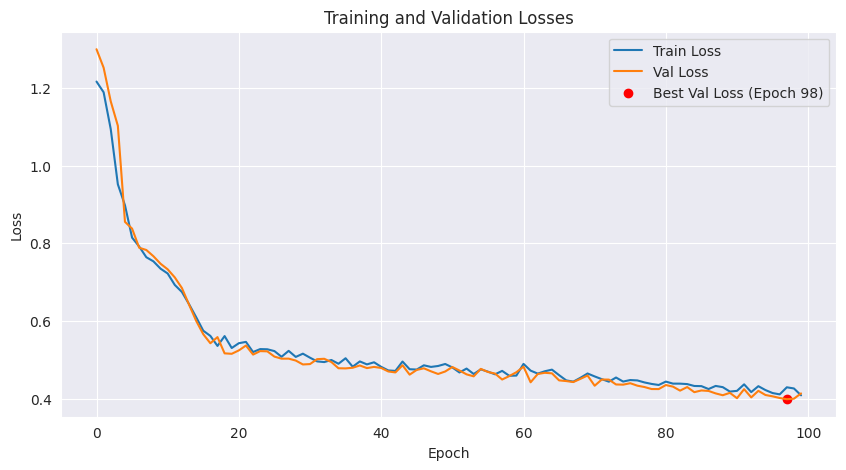

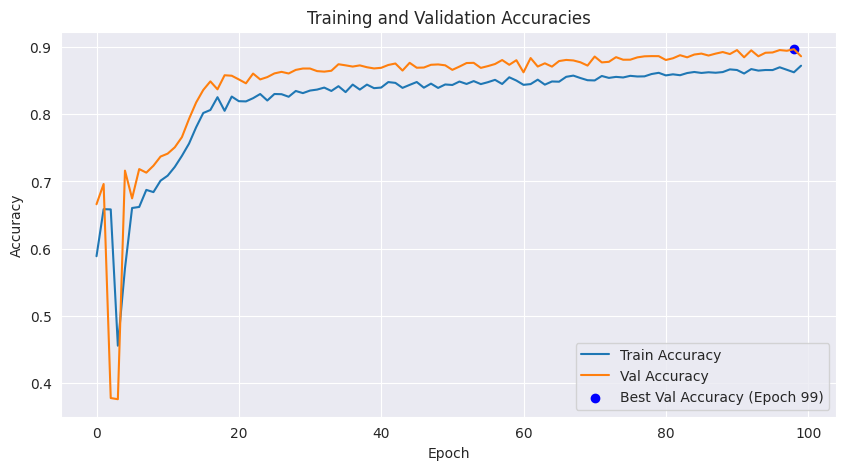

In [ ]:
# # TODO: Plot training and validation losses and accuracies
plt.figure(figsize=(10, 5))
plt.plot(train_losses, label='Train Loss')
plt.plot(val_losses, label='Val Loss')

# Mark best validation loss
plt.scatter(best_val_loss_epoch - 1, best_val_loss, color='red', label=f'Best Val Loss (Epoch {best_val_loss_epoch})')

plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Training and Validation Losses')
plt.legend()
plt.show()

plt.figure(figsize=(10, 5))
# Convert train and validation accuracies to Python floats
train_accuracies_2 = [acc.item() if isinstance(acc, torch.Tensor) else acc for acc in train_accuracies]
val_accuracies_2 = [acc.item() if isinstance(acc, torch.Tensor) else acc for acc in val_accuracies]

plt.plot(train_accuracies_2, label='Train Accuracy')
plt.plot(val_accuracies_2, label='Val Accuracy')

# Mark best validation accuracy
plt.scatter(best_val_accuracy_epoch - 1, best_val_accuracy.item(), color='blue', label=f'Best Val Accuracy (Epoch {best_val_accuracy_epoch})')

plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.title('Training and Validation Accuracies')
plt.legend()
plt.show()


## Plottings

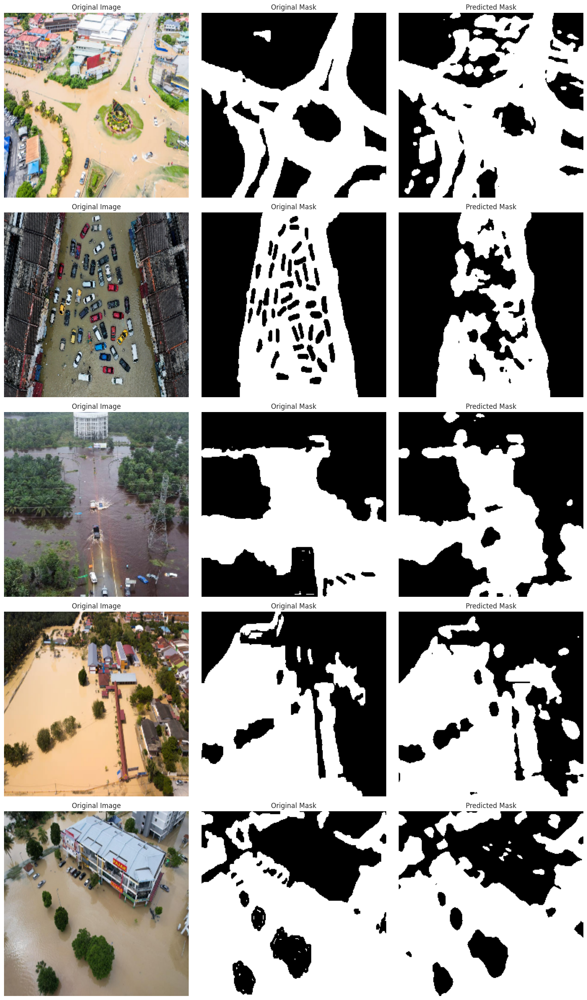

In [ ]:
# Plot the original mask, the one you predicted, and the final one using a threshold

# Function to plot original mask, predicted mask, and processed mask
def plot_results(images, masks, predictions, threshold=0.5):
    # Inverse normalization parameters
    mean = torch.tensor([0.485, 0.456, 0.406]).view(1, 3, 1, 1)
    std = torch.tensor([0.229, 0.224, 0.225]).view(1, 3, 1, 1)

    # Denormalize the images
    images_denormalized = images.cpu() * std + mean

    fig, axes = plt.subplots(len(images), 3, figsize=(15, 5 * len(images)))
    for i, (image, mask, pred) in enumerate(zip(images_denormalized, masks, predictions)):
        # Convert image to NumPy and clip values to valid range [0, 1]
        img_np = image.permute(1, 2, 0).cpu().numpy()
        img_np = img_np.clip(0, 1)  # Ensures proper display

        axes[i, 0].imshow(img_np)
        axes[i, 0].set_title('Original Image')
        axes[i, 0].axis('off')

        axes[i, 1].imshow(mask.squeeze(0).cpu().numpy(), cmap='gray')
        axes[i, 1].set_title('Original Mask')
        axes[i, 1].axis('off')

        axes[i, 2].imshow(pred.squeeze(0).cpu().numpy() > threshold, cmap='gray')
        axes[i, 2].set_title('Predicted Mask')
        axes[i, 2].axis('off')

    plt.tight_layout()
    plt.show()


# Inference on a subset of the validation set
model.eval()
images, masks = next(iter(val_loader))
images = images.to(device)
masks = masks.to(device)

with torch.no_grad():
    predictions = model(images)

# Plot the results
# number_of_images = 10 # بخاطر حجم زیاد
number_of_images = 5
plot_results(images[:number_of_images], masks[:number_of_images], predictions[:number_of_images])


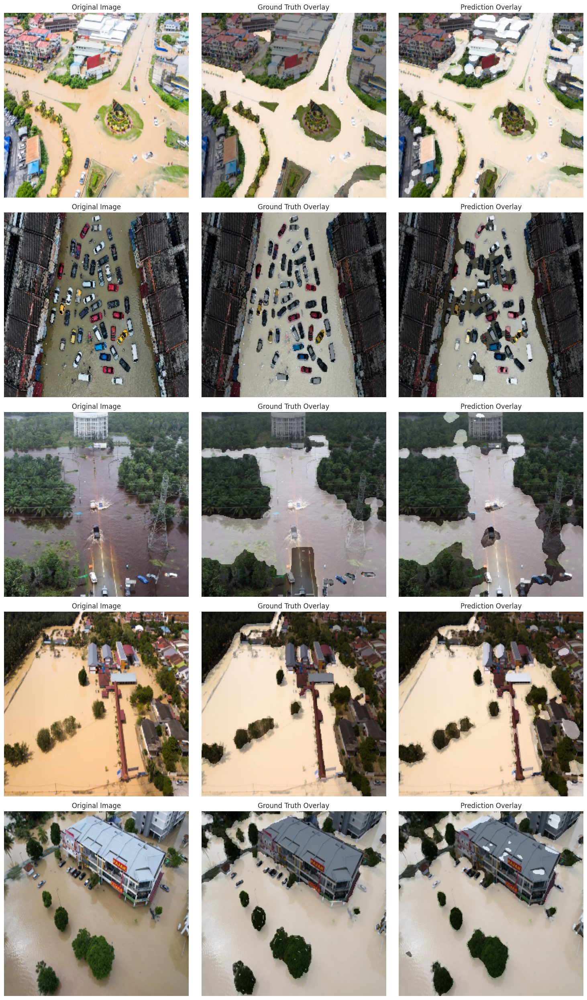

In [ ]:
def plot_results_with_overlay(images, masks, predictions, threshold=0.5):
    """
    Plot original image with overlaid ground truth and predicted masks.
    The masks are blended with transparency for better visualization.
    """
    # Inverse normalization parameters
    mean = torch.tensor([0.485, 0.456, 0.406]).view(1, 3, 1, 1)
    std = torch.tensor([0.229, 0.224, 0.225]).view(1, 3, 1, 1)

    # Denormalize the images
    images_denormalized = images.cpu() * std + mean

    fig, axes = plt.subplots(len(images), 3, figsize=(15, 5 * len(images)))
    for i, (image, mask, pred) in enumerate(zip(images_denormalized, masks, predictions)):
        # Convert image to NumPy and clip values to valid range [0, 1]
        img_np = image.permute(1, 2, 0).cpu().numpy()
        img_np = img_np.clip(0, 1)  # Ensures proper display

        # Ground truth mask
        mask_np = mask.squeeze(0).cpu().numpy()

        # Predicted mask
        pred_np = (pred.squeeze(0).cpu().numpy() > threshold).astype(float)

        # Plot original image
        axes[i, 0].imshow(img_np)
        axes[i, 0].set_title('Original Image')
        axes[i, 0].axis('off')

        # Plot ground truth overlay
        axes[i, 1].imshow(img_np)
        axes[i, 1].imshow(mask_np, cmap='gray', alpha=0.4)


        axes[i, 1].set_title('Ground Truth Overlay')
        axes[i, 1].axis('off')

        # Plot predicted overlay
        axes[i, 2].imshow(img_np)
        axes[i, 2].imshow(pred_np, cmap='gray', alpha=0.4)
        axes[i, 2].set_title('Prediction Overlay')
        axes[i, 2].axis('off')

    plt.tight_layout()
    plt.show()


# Inference on a subset of the validation set
model.eval()
images, masks = next(iter(val_loader))
images = images.to(device)
masks = masks.to(device)

with torch.no_grad():
    predictions = model(images)

# Plot the results
# number_of_images = 10 # بخاطر حجم زیاد
number_of_images = 5
plot_results_with_overlay(images[:number_of_images], masks[:number_of_images], predictions[:number_of_images])


1. **Comparison with Conventional Loss Functions**:
    - How do Dice and Jaccard Losses differ from Cross-Entropy or Mean Squared Error, particularly in terms of sensitivity to class imbalances?
    
    Dice and Jaccard Losses are sensitive to class imbalance, focusing on spatial overlap and segmentation shape, unlike pixel-wise Cross-Entropy Loss and Mean Squared Error. In other words, Dice and Jaccard losses focus on spatial overlap, making them robust to class imbalance, unlike Cross-Entropy and MSE, which treats each pixel independently. This ensures better optimization for small regions.

    more details in sensitivity to Class Imbalances:
        - Cross-Entropy Loss: This loss function is widely used in classification tasks but can be less effective in segmentation tasks with significant class imbalances. It treats each pixel independently and does not account for the spatial relationships between pixels.
        - Mean Squared Error (MSE): This loss function measures the average squared difference between the predicted and actual values. It is sensitive to outliers and does not handle class imbalances well. Also it is not a good chioce for classification tasks like pixel-wise classification in Image segmetation.
        - Dice and Jaccard Losses: These losses are specifically designed to handle class imbalances by focusing on the overlap between the predicted and ground truth masks. They are more sensitive to the spatial relationships between pixels, making them more effective for segmentation tasks.
    - What advantages do these losses offer in capturing the spatial overlap between the predicted and true segmentations?

    Dice Loss: This loss function directly measures the overlap between the predicted and ground truth masks, making it highly effective in capturing the spatial relationships between pixels.

    Jaccard Loss: Similar to Dice Loss, Jaccard Loss measures the intersection over union (IoU) between the predicted and ground truth masks, providing a more robust measure of segmentation accuracy.

    In summary, Dice and Jaccard Losses are tailored for image segmentation tasks, emphasizing the spatial overlap between predicted and true segmentations. Unlike Cross-Entropy, they directly optimize for metrics used in evaluation, making them more robust to class imbalance.


2. **Interpretation of Loss Values**:
    - Discuss what high or low loss scores reveal about the state and effectiveness of your segmentation model.
    
    A low Dice/Jaccard loss indicates strong alignment between predictions and ground truths, reflecting an effective model. High values suggest issues like overfitting or inadequate generalization.

    More details:
        - High Loss Scores:
            - Indicate that the model is not performing well in segmenting the objects of interest. This could be due to poor initialization, inadequate training, or a suboptimal model architecture.
            - Suggest that the model predictions have low overlap with the ground truth masks, resulting in poor segmentation accuracy.
        - Low Loss Scores:
            - Indicate that the model is performing well in segmenting the objects of interest. This suggests that the model predictions have high overlap with the ground truth masks, resulting in accurate segmentation.
            - Reflect the effectiveness of the model in capturing the spatial relationships between pixels and handling class imbalances.

Evaluate the role of the attention mechanism in optimizing segmentation accuracy in cluttered environments. How does it refine the segmentation process?

As shown in the attached paper, attention gates suppress irrelevant regions and enhance the network's ability to focus on target structures in cluttered backgrounds. Models trained with AGs implicitly learn to suppress irrelevant regions in an input image while highlighting salient features useful for a specific task. This enables us to eliminate the necessity of using explicit external tissue/organ localisation modules of cascaded convolutional neural networks (CNNs). AGs can be easily integrated into standard CNN architectures such as the U-Net model with minimal computational overhead while increasing the model sensitivity and prediction accuracy.
In other words, the attention mechanism in U-Net helps optimize segmentation accuracy in cluttered environments by:    
- Focusing on Relevant Features: The attention gates filter out irrelevant features and highlight salient features, allowing the model to focus on the most relevant parts of the image.
- Improving Feature Representation: By selectively emphasizing important features, the attention mechanism enhances the feature representation, leading to more accurate segmentation.
- Handling Complex Backgrounds: In cluttered environments, the attention mechanism helps the model distinguish between the object of interest and the background, improving segmentation accuracy.


What is the importance of skip connections in U-Net, and how do they enhance the accuracy of segmentation tasks?

Skip connections pass fine-grained details to the decoding stage, essential for reconstructing high-resolution segmentations while reducing vanishing gradients.

Actually Skip connections in U-Net enhance the accuracy of segmentation tasks by:

- Preserving Spatial Information: Skip connections allow the model to preserve spatial information from the encoder layers, which is crucial for accurate segmentation.
- Combining Low-Level and High-Level Features: By combining low-level features (e.g., edges, textures) from the encoder layers with high-level features (e.g., object shapes) from the decoder layers, skip connections enable the model to capture both local and global context, leading to more accurate segmentation.
- Mitigating the Vanishing Gradient Problem: Skip connections help mitigate the vanishing gradient problem by allowing gradients to flow more easily through the network, facilitating better training and convergence.

Explain the difference between the predicted and processed mask above.

Processed masks undergo thresholding to produce binary outputs. Differences highlight model sensitivity in distinguishing target boundaries.

- Predicted Mask: This is the raw output of the model, which contains probability values for each pixel indicating the likelihood of belonging to the segmented object.
- Processed Mask: This is the final segmentation mask obtained by applying a threshold to the predicted mask. Pixels with probability values above the threshold are considered part of the segmented object, while those below the threshold are considered background. The processed mask provides a binary representation of the segmented object, making it easier to interpret and evaluate.